## Sim Demo

### Imports

In [8]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [9]:
from env.imports import *

In [10]:
import importlib
import data

import models
import sim.sim
import sim.sim_utils
from sim.sim_utils import bytes2human, print_system_usage
from sim.sim import Simulation
from sim.sim_run import single_sim_run

importlib.reload(sim.sim)
importlib.reload(sim.sim_run)
importlib.reload(models.train_val)
importlib.reload(data.data_utils)
importlib.reload(data.data_load)


<module 'data.data_load' from '/scratch/asr655/neuroinformatics/GeneEx2Conn/data/data_load.py'>

#### Check job specs

In [11]:
print_system_usage()

total = psutil.disk_usage('/').total
print(bytes2human(total))

CPU Usage: 30.7%
RAM Usage: 5.6%
Available RAM: 1.4T
Total RAM: 1.5T
52.4G


In [12]:
print(os.environ.get("CUDA_VISIBLE_DEVICES"))

# Check available GPUs
print(f"Available GPUs: {torch.cuda.device_count()}")

for i in range(torch.cuda.device_count()):
    print(f"GPU {i}: {torch.cuda.get_device_name(i)} - Memory Allocated: {torch.cuda.memory_allocated(i)/1024**3:.2f} GB")


0
Available GPUs: 1
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.00 GB


In [13]:
print("XGBoost version:", xgboost.__version__)
print("cupy version:", cp.__version__)

GPUtil.getAvailable()

# if a number is seen a GPU is available
GPUtil.getGPUs()

DEVICE_ID_LIST = GPUtil.getFirstAvailable()
DEVICE_ID = DEVICE_ID_LIST[0] # grab first element from list
if DEVICE_ID != None: 
    print('GPU found', DEVICE_ID)
    use_gpu = True

    GPUtil.showUtilization()

XGBoost version: 2.0.3
cupy version: 13.1.0
GPU found 0
| ID | GPU | MEM |
------------------
|  0 |  0% |  0% |


In [14]:
torch.cuda.is_available()

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

## Simulation tests <a id="sims"></a>

In [15]:
torch._dynamo.reset()

Number of components for 95% variance PCA: 27
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 7380)
X_pca shape: (455, 27)
X_pca_full shape: (455, 455)
X_cell_types_Jorstad shape: (455, 24)
X_cell_types_LakeDFC shape: (455, 18)
X_cell_types_LakeVIS shape: (455, 18)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
connectome target FC
Y shape (455, 455)
Network coverage: 100.0% of regions
Network sizes: [113, 113, 113, 116]
feature_name: transcriptome, processing_type: None
features ['transcriptome']
Feature matrix, X, generated... expanding to pairwise dataset


  return LooseVersion(v) >= LooseVersion(check)

ERROR: Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.
wandb: Using wandb-core as the SDK backend. Please refer to https://wandb.me/wandb-core for more information.
wandb: Currently logged in as: asratzan (alexander-ratzan-new-york-university). Use `wandb login --relogin` to force relogin
wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: d04cltxv
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/d04cltxv
Initialized sweep with ID: d04cltxv
2
3
4
BEST CONFIG {'input_dim': 14760, 'token_encoder_dim': 20, 'd_model': 128, 'encoder_output_dim': 10, 'use_alibi': True, 'nhead': 4, 'num_layers': 4, 'deep_hidden_dims': [512, 256, 128], 'cls_init': 'spatial_learned', 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 0.0001, 'weight_decay': 0.0001, 'batch_size': 512, 'aug_prob': 0.3, 'aug_style': 'curriculum_swap_linear_decay', 'epochs': 110, 'num_workers': 1, 'prefetch_factor': 1}


  warnings.warn(



Number of learnable parameters in SMT w/ CLS model: 4686987


  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



  from IPython.core.display import HTML, display  # type: ignore



Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.02 GB
Best val loss so far at epoch 1: 0.0412
Best val loss so far at epoch 2: 0.0364
Best val loss so far at epoch 3: 0.0342
Epoch 5/110, Train Loss: 0.0765, Val Loss: 0.0639, Time: 11.04s
Epoch 10/110, Train Loss: 0.0455, Val Loss: 0.0561, Time: 10.57s
Epoch 15/110, Train Loss: 0.0457, Val Loss: 0.0679, Time: 10.75s
Epoch 20/110, Train Loss: 0.0386, Val Loss: 0.0656, Time: 10.48s
Epoch 25/110, Train Loss: 0.0409, Val Loss: 0.0436, Time: 10.88s
Epoch 30/110, Train Loss: 0.0359, Val Loss: 0.0930, Time: 10.50s

LR REDUCED: 0.000100 → 0.000030 at Val Loss: 0.091791
Epoch 35/110, Train Loss: 0.0360, Val Loss: 0.0664, Time: 10.62s
Epoch 40/110, Train Loss: 0.0299, Val Loss: 0.0803, Time: 10.28s
Epoch 45/110, Train Loss: 0.0305, Val Loss: 0.0725, Time: 10.40s
Epoch 50/110, Train Loss: 0.0249, Val Loss: 0.0788, Time: 10.09s

Early stopping triggered at epoch 53. Restoring best model with Val Loss: 0.0342, Pearson Correlati

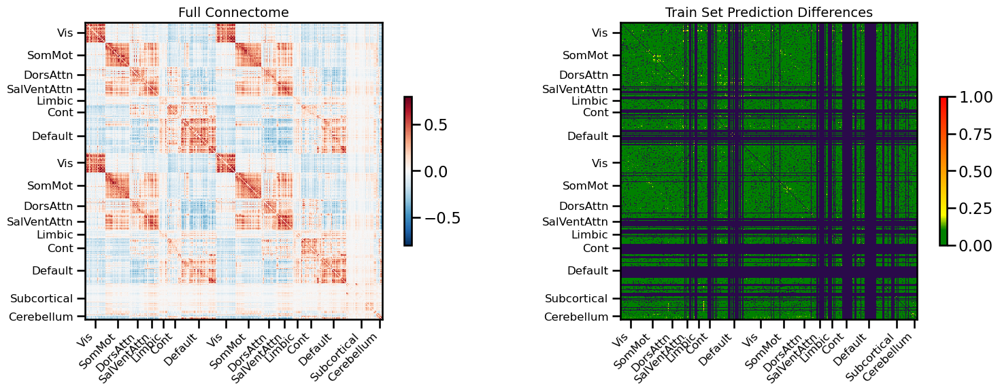

<Figure size 640x480 with 0 Axes>

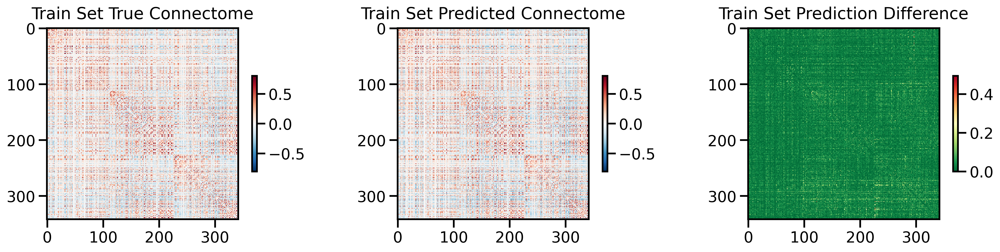

<Figure size 640x480 with 0 Axes>

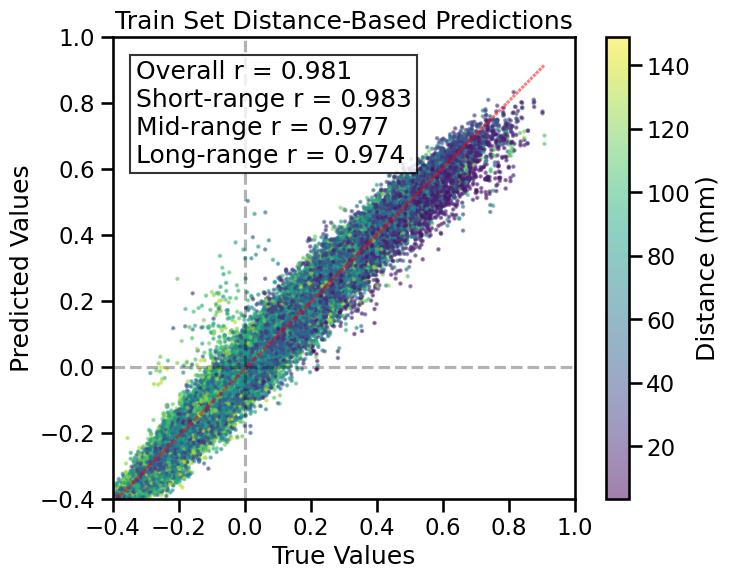

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 113 regions, 12656 connections


<Figure size 640x480 with 0 Axes>

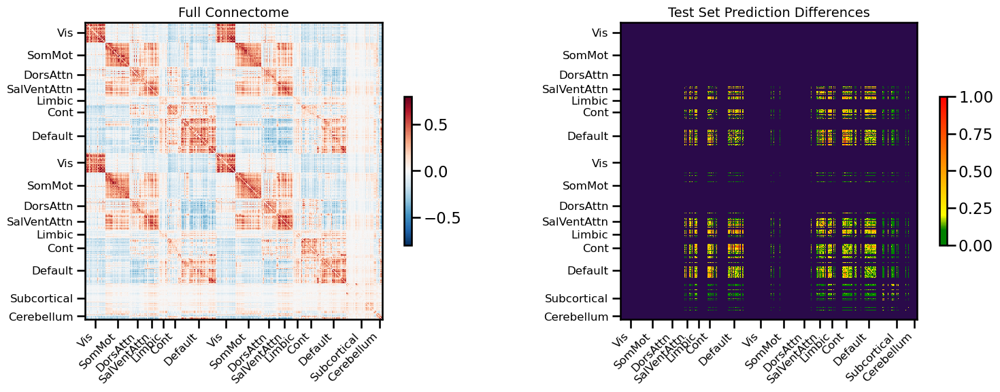

<Figure size 640x480 with 0 Axes>

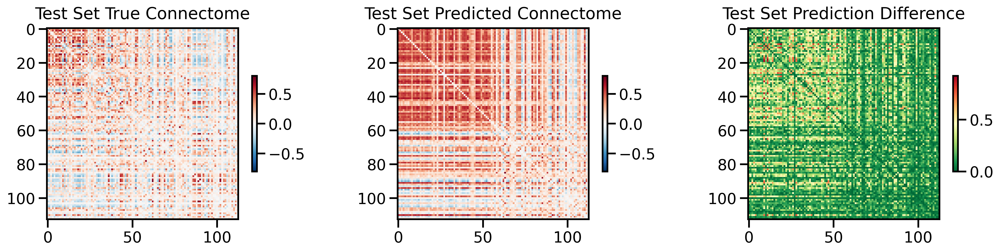

<Figure size 640x480 with 0 Axes>

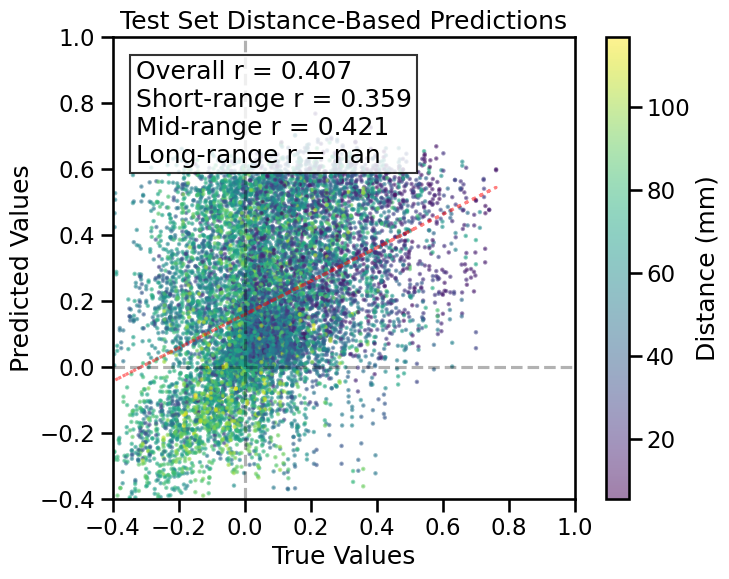

TRAIN METRICS
GLOBAL: mse=0.001576, mae=0.029339, r2=0.9581, pearson_r=0.9806, spearman_r=0.9743, geodesic_distance=13.3854
DISTANCE-BASED: short=0.9834, mid=0.9771, long=0.9738
HEMISPHERIC: left=0.9796, right=0.9837, inter=0.9825
CONNECTION STRENGTH: neg=0.7400, weak=0.9626, pos=0.8912
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.9781    0.9787
  Default       0.9777    0.9794
  SalVentAttn    0.9795    0.9780
  Limbic        0.9770    0.9789
  DorsAttn      0.9811    0.9805
  SomMot        0.9822    0.9804
  Vis           0.9801    0.9796
  Subcortical    0.9796    0.9813
  Cerebellum    0.9338    0.9771

TEST METRICS
GLOBAL: mse=0.067701, mae=0.194537, r2=-1.0048, pearson_r=0.4068, spearman_r=0.3928, geodesic_distance=13.7061
DISTANCE-BASED: short=0.3588, mid=0.4206
HEMISPHERIC: left=0.4159, right=0.4867, inter=0.3510
CONNECTION STRENGTH: neg=-0.0696, weak=0.3194, pos=0.0757
NETWORK CORRELATIONS:
  NETWORK      INTRA      I

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,▁▁▂▅▄▄▄▅▃█▆▅▆▆▄▆▇█▅▂▇▇▅▇▅▆▄▇▆▆█▆▇▆▆█▆▇▅▆
train_mse_loss,█▄▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
best_val_loss,0
test_mse_loss,0.06707
train_mse_loss,0.02804


Final evaluation metrics logged successfully.


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: 90cve5bs
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/90cve5bs
Initialized sweep with ID: 90cve5bs


  warnings.warn(

  self.comm = Comm(**args)



1
3
4
BEST CONFIG {'input_dim': 14760, 'token_encoder_dim': 20, 'd_model': 128, 'encoder_output_dim': 10, 'use_alibi': True, 'nhead': 4, 'num_layers': 4, 'deep_hidden_dims': [512, 256, 128], 'cls_init': 'spatial_learned', 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 0.0001, 'weight_decay': 0.0001, 'batch_size': 512, 'aug_prob': 0.3, 'aug_style': 'curriculum_swap_linear_decay', 'epochs': 110, 'num_workers': 1, 'prefetch_factor': 1}
Number of learnable parameters in SMT w/ CLS model: 4686987


  from IPython.core.display import HTML, display  # type: ignore



Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.15 GB
Best val loss so far at epoch 1: 0.0353
Best val loss so far at epoch 2: 0.0275
Epoch 5/110, Train Loss: 0.0722, Val Loss: 0.0348, Time: 11.83s
Best val loss so far at epoch 9: 0.0262
Epoch 10/110, Train Loss: 0.0473, Val Loss: 0.0279, Time: 11.36s
Best val loss so far at epoch 13: 0.0241
Best val loss so far at epoch 14: 0.0201
Epoch 15/110, Train Loss: 0.0434, Val Loss: 0.0204, Time: 11.38s
Best val loss so far at epoch 18: 0.0194
Epoch 20/110, Train Loss: 0.0406, Val Loss: 0.0204, Time: 11.49s
Best val loss so far at epoch 23: 0.0166
Best val loss so far at epoch 24: 0.0163
Best val loss so far at epoch 25: 0.0159
Epoch 25/110, Train Loss: 0.0366, Val Loss: 0.0159, Time: 11.20s
Best val loss so far at epoch 26: 0.0148
Epoch 30/110, Train Loss: 0.0317, Val Loss: 0.0177, Time: 11.00s
Best val loss so far at epoch 31: 0.0143
Epoch 35/110, Train Loss: 0.0295, Val Loss: 0.0167, Time: 10.87s
Best val loss so far a

<Figure size 640x480 with 0 Axes>

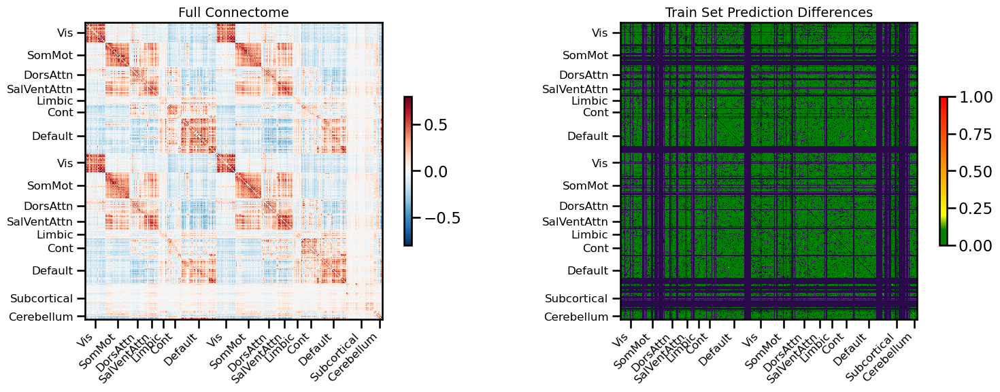

<Figure size 640x480 with 0 Axes>

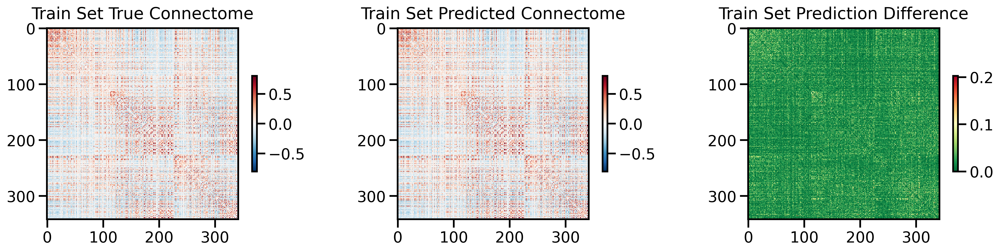

<Figure size 640x480 with 0 Axes>

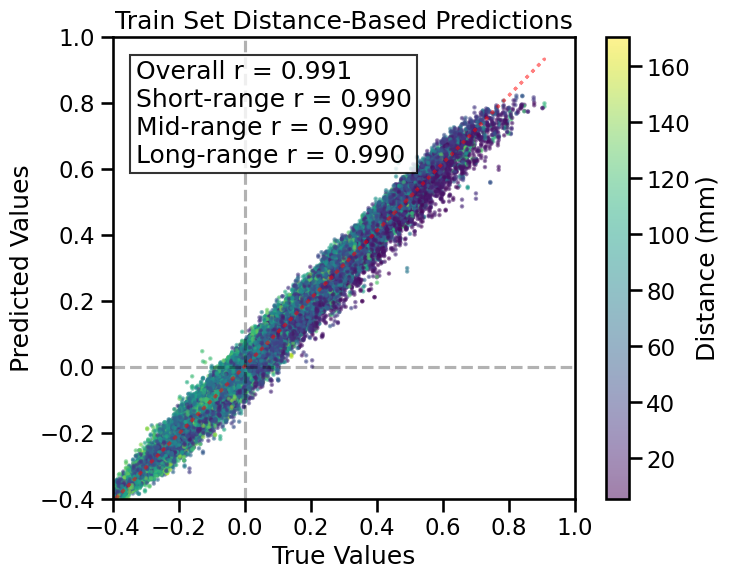

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 113 regions, 12656 connections


<Figure size 640x480 with 0 Axes>

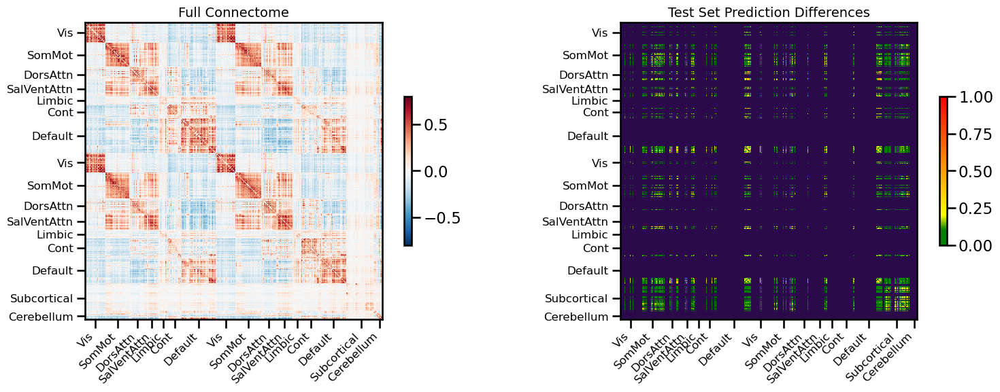

<Figure size 640x480 with 0 Axes>

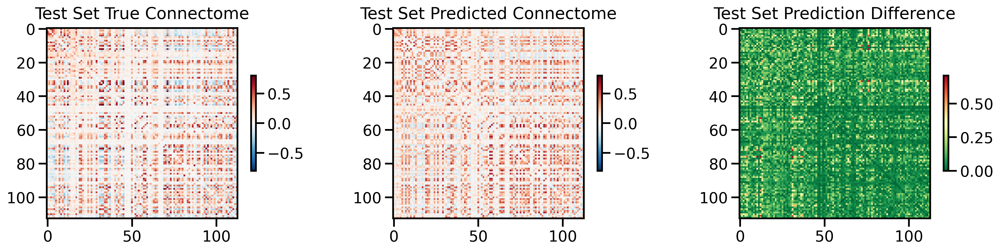

<Figure size 640x480 with 0 Axes>

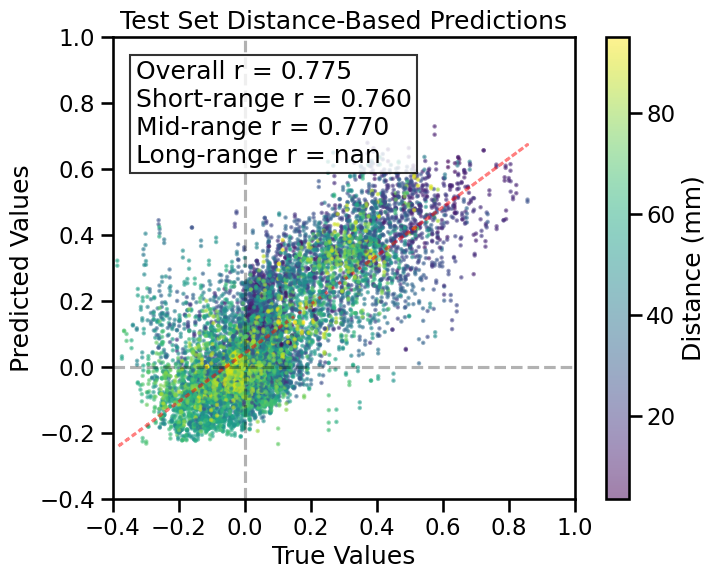

TRAIN METRICS
GLOBAL: mse=0.000769, mae=0.021132, r2=0.9794, pearson_r=0.9908, spearman_r=0.9874, geodesic_distance=11.8683
DISTANCE-BASED: short=0.9903, mid=0.9899, long=0.9898
HEMISPHERIC: left=0.9907, right=0.9914, inter=0.9905
CONNECTION STRENGTH: neg=0.8651, weak=0.9824, pos=0.9465
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.9905    0.9894
  Default       0.9906    0.9900
  SalVentAttn    0.9912    0.9894
  Limbic        0.9883    0.9889
  DorsAttn      0.9882    0.9891
  SomMot        0.9865    0.9883
  Vis           0.9883    0.9886
  Subcortical    0.9824    0.9881
  Cerebellum    0.9947    0.9894

TEST METRICS
GLOBAL: mse=0.015609, mae=0.091161, r2=0.5528, pearson_r=0.7745, spearman_r=0.6919, geodesic_distance=10.8443
DISTANCE-BASED: short=0.7598, mid=0.7703
HEMISPHERIC: left=0.7960, right=0.7677, inter=0.7668
CONNECTION STRENGTH: weak=0.5847, pos=0.3401
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  -------

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,█▇▇▅▅▃▃▃▃▂▂▂▁▂▂▂▃▁▁▁▁▁▂▁▂▁▂▁▂▁▁▁▁▂▂▁▂▂▂▁
train_mse_loss,█▆▅▄▅▅▄▄▄▄▄▄▄▄▄▃▃▃▃▃▃▂▃▃▃▂▂▂▂▂▂▂▂▁▂▁▁▁▁▁
best_val_loss,0
test_mse_loss,0.01556
train_mse_loss,0.00251


Final evaluation metrics logged successfully.


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: ld961h32
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/ld961h32
Initialized sweep with ID: ld961h32


  warnings.warn(

  self.comm = Comm(**args)



1
2
4
BEST CONFIG {'input_dim': 14760, 'token_encoder_dim': 20, 'd_model': 128, 'encoder_output_dim': 10, 'use_alibi': True, 'nhead': 4, 'num_layers': 4, 'deep_hidden_dims': [512, 256, 128], 'cls_init': 'spatial_learned', 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 0.0001, 'weight_decay': 0.0001, 'batch_size': 512, 'aug_prob': 0.3, 'aug_style': 'curriculum_swap_linear_decay', 'epochs': 110, 'num_workers': 1, 'prefetch_factor': 1}
Number of learnable parameters in SMT w/ CLS model: 4686987


  from IPython.core.display import HTML, display  # type: ignore



Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.15 GB
Best val loss so far at epoch 1: 0.0426
Best val loss so far at epoch 3: 0.0322
Best val loss so far at epoch 4: 0.0290
Best val loss so far at epoch 5: 0.0284
Epoch 5/110, Train Loss: 0.0729, Val Loss: 0.0284, Time: 11.45s
Best val loss so far at epoch 6: 0.0270
Epoch 10/110, Train Loss: 0.0434, Val Loss: 0.0303, Time: 11.00s
Epoch 15/110, Train Loss: 0.0438, Val Loss: 0.0323, Time: 12.24s
Epoch 20/110, Train Loss: 0.0381, Val Loss: 0.0371, Time: 11.19s
Epoch 25/110, Train Loss: 0.0321, Val Loss: 0.0287, Time: 10.89s
Best val loss so far at epoch 26: 0.0267
Epoch 30/110, Train Loss: 0.0316, Val Loss: 0.0276, Time: 10.83s
Best val loss so far at epoch 33: 0.0262
Epoch 35/110, Train Loss: 0.0331, Val Loss: 0.0327, Time: 11.24s

LR REDUCED: 0.000100 → 0.000030 at Val Loss: 0.027041
Best val loss so far at epoch 37: 0.0256
Best val loss so far at epoch 40: 0.0234
Epoch 40/110, Train Loss: 0.0251, Val Loss: 0.0234,

<Figure size 640x480 with 0 Axes>

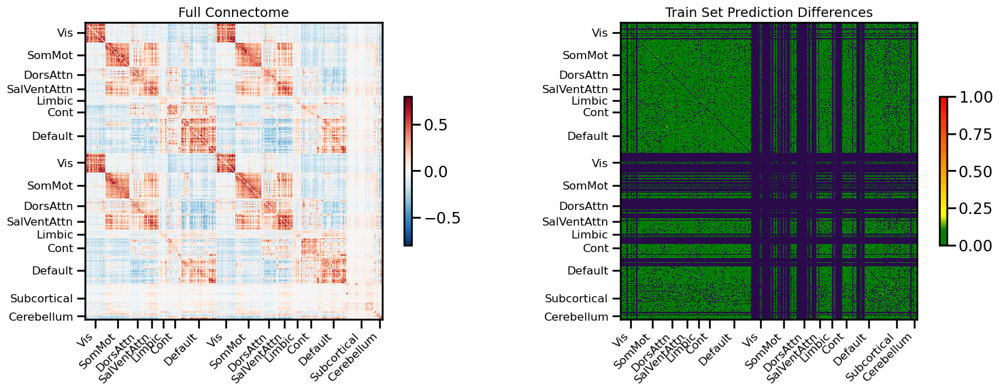

<Figure size 640x480 with 0 Axes>

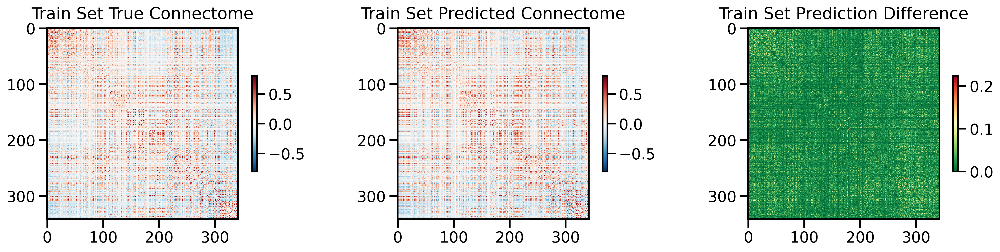

<Figure size 640x480 with 0 Axes>

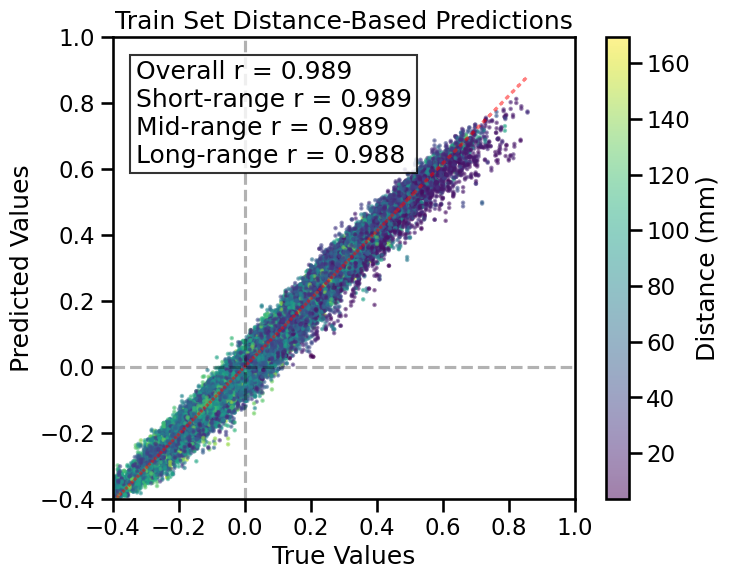

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 113 regions, 12656 connections


<Figure size 640x480 with 0 Axes>

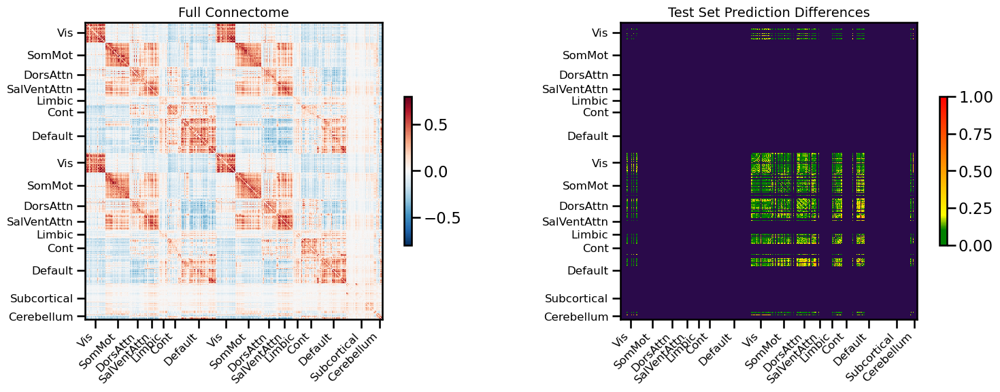

<Figure size 640x480 with 0 Axes>

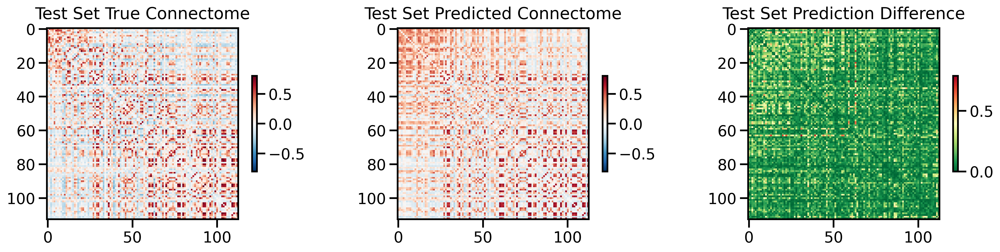

<Figure size 640x480 with 0 Axes>

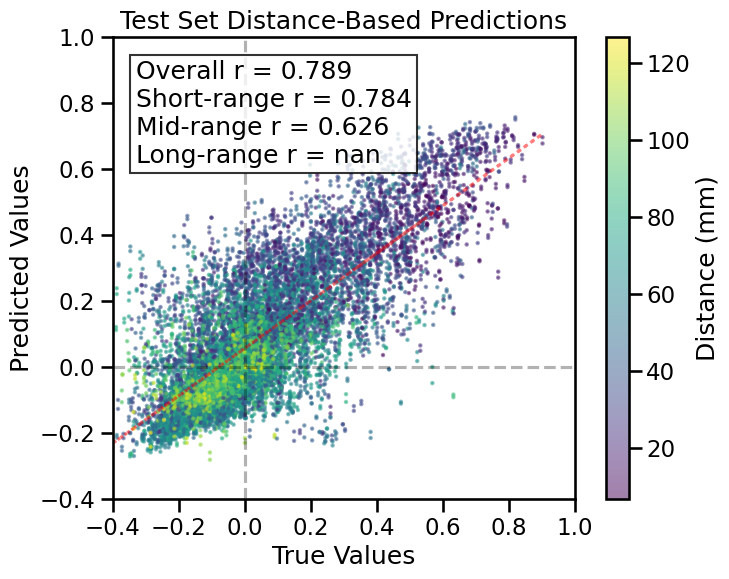

TRAIN METRICS
GLOBAL: mse=0.000746, mae=0.020402, r2=0.9765, pearson_r=0.9894, spearman_r=0.9851, geodesic_distance=14.3026
DISTANCE-BASED: short=0.9894, mid=0.9886, long=0.9880
HEMISPHERIC: left=0.9894, right=0.9890, inter=0.9893
CONNECTION STRENGTH: neg=0.8136, weak=0.9811, pos=0.9329
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.9898    0.9886
  Default       0.9906    0.9895
  SalVentAttn    0.9897    0.9880
  Limbic        0.9873    0.9876
  DorsAttn      0.9844    0.9879
  SomMot        0.9842    0.9871
  Vis           0.9815    0.9877
  Subcortical    0.9834    0.9857
  Cerebellum    0.9951    0.9886

TEST METRICS
GLOBAL: mse=0.022125, mae=0.108227, r2=0.5742, pearson_r=0.7888, spearman_r=0.7326, geodesic_distance=9.1959
DISTANCE-BASED: short=0.7835, mid=0.6256
HEMISPHERIC: left=0.9269, right=0.7762, inter=0.8561
CONNECTION STRENGTH: neg=-0.0099, weak=0.6091, pos=0.5610
NETWORK CORRELATIONS:
  NETWORK      INTRA      INT

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,▅▅▅▄▆▄▅▄▄█▃▄▃▃▂▃▂▂▃▃▃▁▂▂▁▃▃▂▃▃▁▂▂▁▂▂▁▂▂▁
train_mse_loss,█▄▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
best_val_loss,0
test_mse_loss,0.02206
train_mse_loss,0.0022


Final evaluation metrics logged successfully.


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: c31lw2o9
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/c31lw2o9
Initialized sweep with ID: c31lw2o9


  warnings.warn(

  self.comm = Comm(**args)



1
2
3
BEST CONFIG {'input_dim': 14760, 'token_encoder_dim': 20, 'd_model': 128, 'encoder_output_dim': 10, 'use_alibi': True, 'nhead': 4, 'num_layers': 4, 'deep_hidden_dims': [512, 256, 128], 'cls_init': 'spatial_learned', 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 0.0001, 'weight_decay': 0.0001, 'batch_size': 512, 'aug_prob': 0.3, 'aug_style': 'curriculum_swap_linear_decay', 'epochs': 110, 'num_workers': 1, 'prefetch_factor': 1}
Number of learnable parameters in SMT w/ CLS model: 4686987


  from IPython.core.display import HTML, display  # type: ignore



Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.15 GB
Best val loss so far at epoch 1: 0.0524
Best val loss so far at epoch 2: 0.0435
Best val loss so far at epoch 3: 0.0414
Best val loss so far at epoch 5: 0.0406
Epoch 5/110, Train Loss: 0.0699, Val Loss: 0.0406, Time: 11.16s
Best val loss so far at epoch 6: 0.0400
Best val loss so far at epoch 7: 0.0372
Best val loss so far at epoch 8: 0.0351
Best val loss so far at epoch 9: 0.0337
Epoch 10/110, Train Loss: 0.0432, Val Loss: 0.0338, Time: 11.02s
Best val loss so far at epoch 11: 0.0328
Best val loss so far at epoch 12: 0.0317
Best val loss so far at epoch 13: 0.0301
Epoch 15/110, Train Loss: 0.0447, Val Loss: 0.0324, Time: 11.37s
Best val loss so far at epoch 16: 0.0298
Epoch 20/110, Train Loss: 0.0420, Val Loss: 0.0324, Time: 11.38s
Epoch 25/110, Train Loss: 0.0369, Val Loss: 0.0301, Time: 11.43s
Epoch 30/110, Train Loss: 0.0290, Val Loss: 0.0302, Time: 10.83s
Best val loss so far at epoch 33: 0.0275
Epoch 35/1

<Figure size 640x480 with 0 Axes>

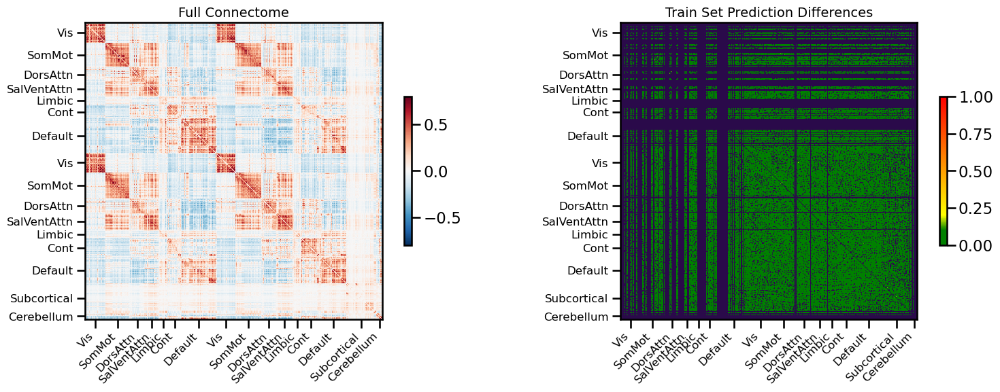

<Figure size 640x480 with 0 Axes>

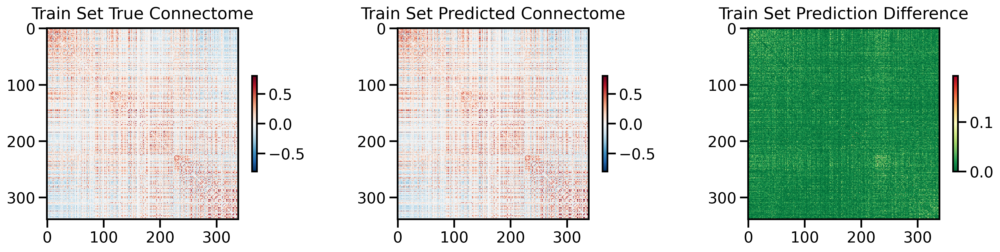

<Figure size 640x480 with 0 Axes>

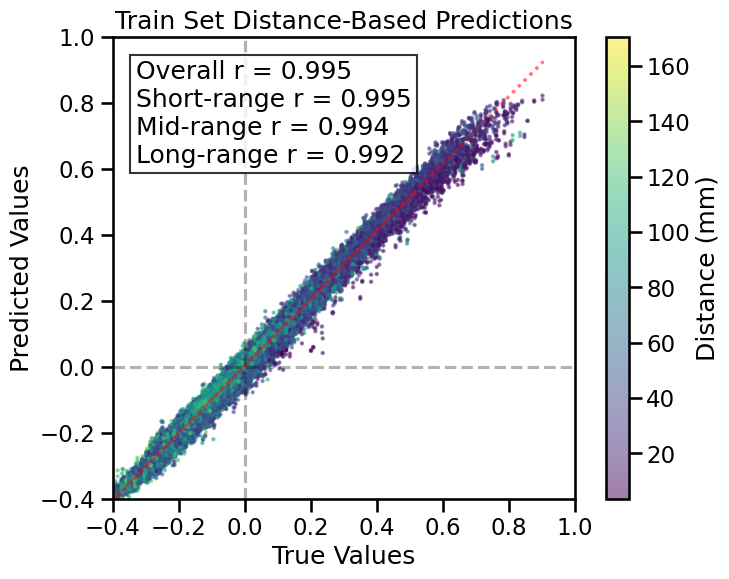

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 116 regions, 13340 connections


<Figure size 640x480 with 0 Axes>

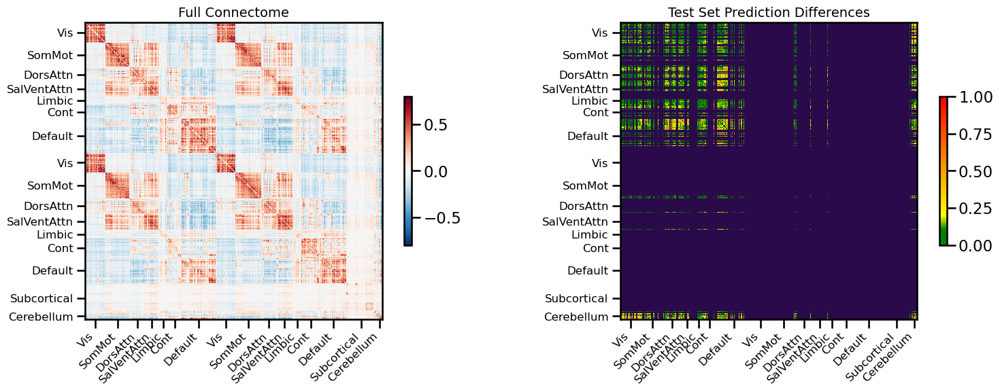

<Figure size 640x480 with 0 Axes>

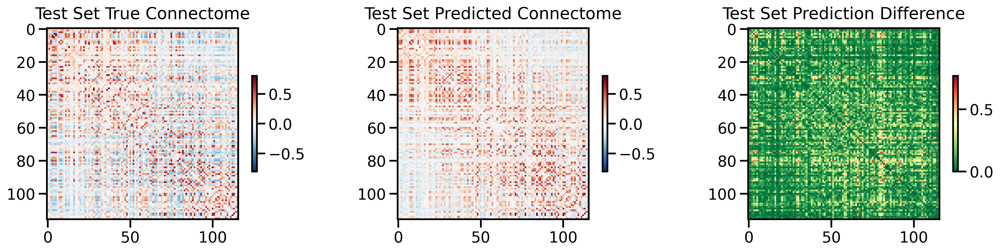

<Figure size 640x480 with 0 Axes>

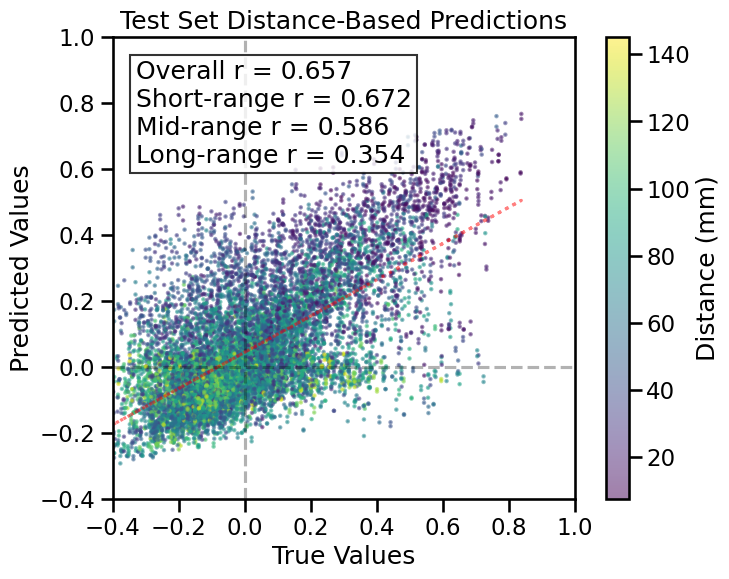

TRAIN METRICS
GLOBAL: mse=0.000369, mae=0.014604, r2=0.9883, pearson_r=0.9949, spearman_r=0.9925, geodesic_distance=11.9431
DISTANCE-BASED: short=0.9951, mid=0.9942, long=0.9924
HEMISPHERIC: left=0.9948, right=0.9949, inter=0.9949
CONNECTION STRENGTH: neg=0.8918, weak=0.9907, pos=0.9683
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.9949    0.9946
  Default       0.9949    0.9947
  SalVentAttn    0.9937    0.9942
  Limbic        0.9934    0.9933
  DorsAttn      0.9946    0.9940
  SomMot        0.9932    0.9941
  Vis           0.9945    0.9940
  Subcortical    0.9930    0.9937
  Cerebellum       N/A    0.9950

TEST METRICS
GLOBAL: mse=0.028849, mae=0.120984, r2=0.3742, pearson_r=0.6570, spearman_r=0.5942, geodesic_distance=11.9200
DISTANCE-BASED: short=0.6717, mid=0.5861, long=0.3543
HEMISPHERIC: left=0.6421, right=0.9046, inter=0.7656
CONNECTION STRENGTH: neg=0.1273, weak=0.4954, pos=0.4382
NETWORK CORRELATIONS:
  NETWORK      I

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,█▆▅▅▃▃▂▂▂▂▂▁▂▂▂▁▂▂▁▂▁▂▂▂▁▂▂▁▁▁▂▁▂▂▁▂▂▁▁▂
train_mse_loss,█▇▅▄▄▃▃▃▃▃▃▃▃▂▂▃▂▃▂▂▂▂▂▂▂▂▂▂▁▂▂▁▂▁▁▁▁▁▁▁
best_val_loss,0
test_mse_loss,0.02798
train_mse_loss,0.00153


Final evaluation metrics logged successfully.
CPU Usage: 32.5%
RAM Usage: 9.2%
Available RAM: 1.3T
Total RAM: 1.5T
| ID | GPU | MEM |
------------------
|  0 |  0% |  1% |
Sim complete
Simulation completed in 4272.39 seconds (71.21 minutes)


8535

<Figure size 640x480 with 0 Axes>

In [16]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              train_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              dataset='UKBB',
              parcellation='S456',
              hemisphere='both',
              connectome_target='FC',
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='0.2',
              cv_type='spatial',
              random_seed=9,
              search_method=('wandb', 'mse', 2),
              track_wandb=True,
              skip_cv=True,
              model_type='shared_transformer_cls',
              use_gpu=True,
              null_model='none',
              use_folds=[3, 2, 1, 0]
)

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

Number of components for 95% variance PCA: 3
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 100)
X_pca shape: (455, 3)
X_pca_full shape: (455, 100)
X_cell_types_Jorstad shape: (455, 24)
X_cell_types_LakeDFC shape: (455, 18)
X_cell_types_LakeVIS shape: (455, 18)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
connectome target FC
Y shape (455, 455)
feature_name: transcriptome, processing_type: None
features ['transcriptome']
Feature matrix, X, generated... expanding to pairwise dataset


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: tywmee2y
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/tywmee2y
Initialized sweep with ID: tywmee2y


  warnings.warn(



2
3
4
BEST CONFIG {'input_dim': 200, 'learning_rate': 0.0005, 'batch_size': 512, 'regularization': 'l2', 'lambda_reg': 0.1, 'epochs': 100}
Total number of learnable parameters in BilinearCMmodel: 10001
Running train evaluation...

=== TRAIN EVALUATION ===
Evaluating 341 regions, 115940 connections


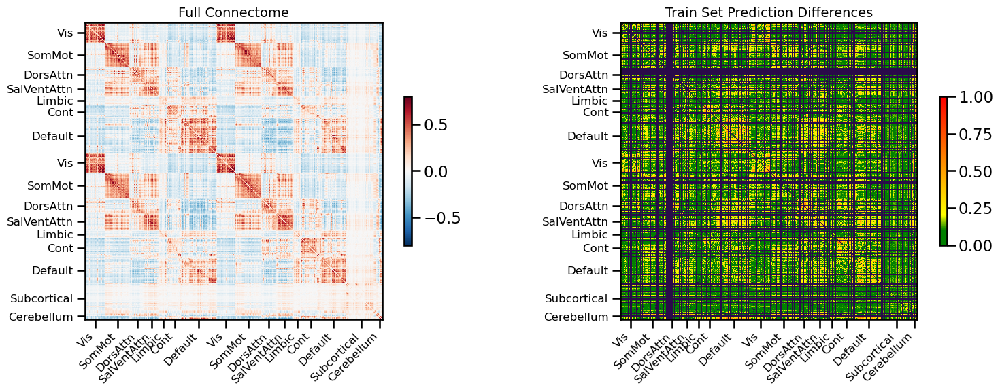

<Figure size 640x480 with 0 Axes>

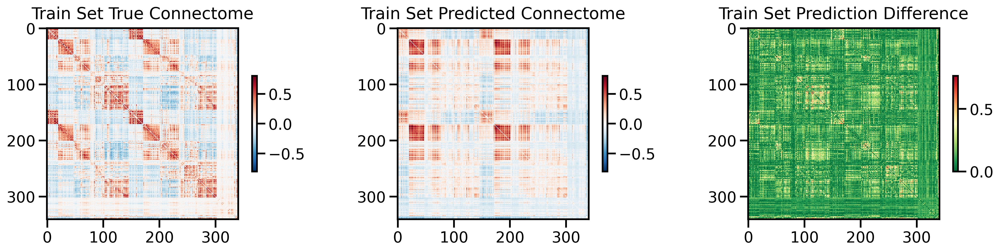

<Figure size 640x480 with 0 Axes>

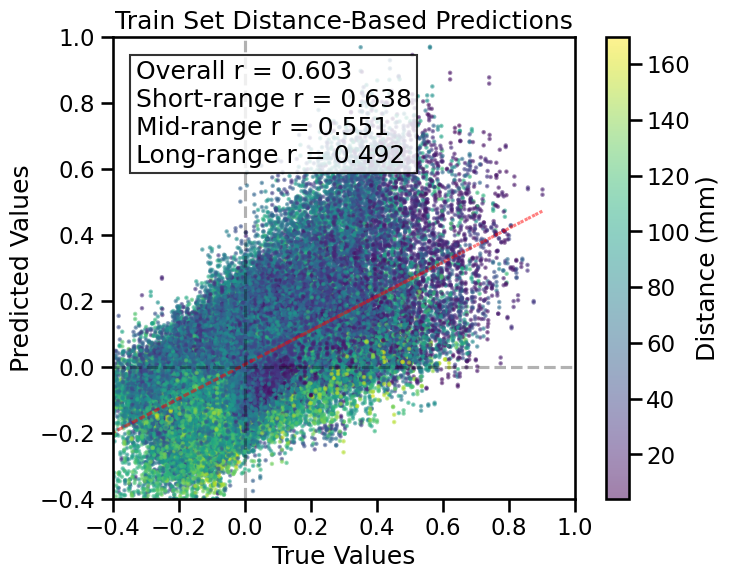

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 114 regions, 12882 connections


<Figure size 640x480 with 0 Axes>

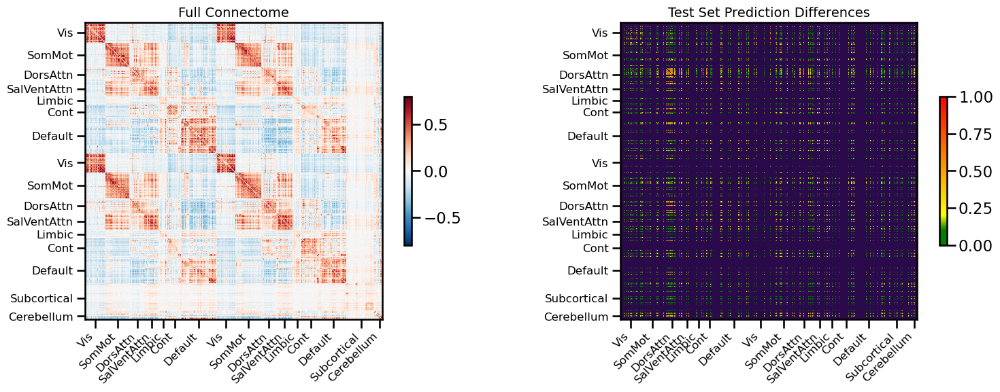

<Figure size 640x480 with 0 Axes>

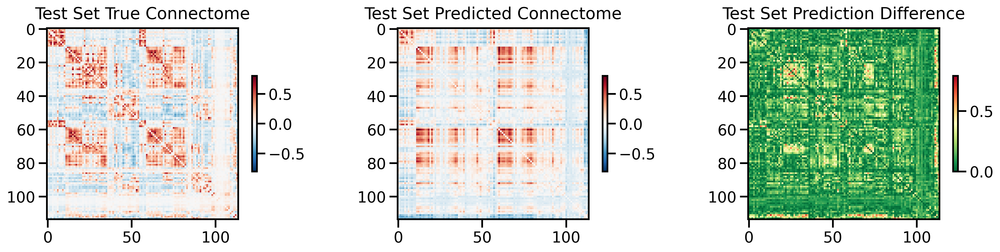

<Figure size 640x480 with 0 Axes>

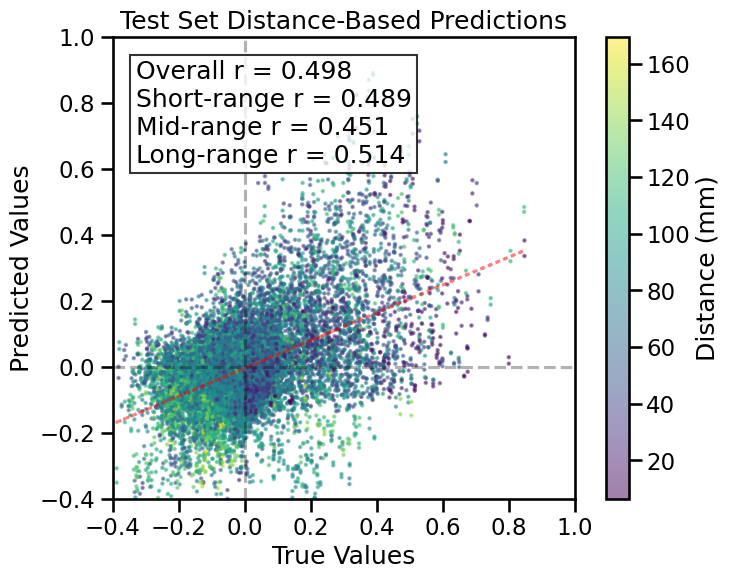

TRAIN METRICS
GLOBAL: mse=0.023716, mae=0.120748, r2=0.2999, pearson_r=0.6029, spearman_r=0.5363, geodesic_distance=32.1032
DISTANCE-BASED: short=0.6380, mid=0.5508, long=0.4925
HEMISPHERIC: left=0.5787, right=0.5874, inter=0.6188
CONNECTION STRENGTH: neg=0.0591, weak=0.4896, pos=0.1610
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.6903    0.6767
  Default       0.4219    0.6188
  SalVentAttn    0.7547    0.7025
  Limbic        0.7138    0.6989
  DorsAttn      0.7797    0.7211
  SomMot        0.7543    0.7073
  Vis           0.6893    0.6831
  Subcortical    0.3316    0.6111
  Cerebellum    0.4620    0.5843

TEST METRICS
GLOBAL: mse=0.028897, mae=0.129667, r2=0.1174, pearson_r=0.4979, spearman_r=0.4330, geodesic_distance=18.4930
DISTANCE-BASED: short=0.4890, mid=0.4511, long=0.5145
HEMISPHERIC: left=0.4612, right=0.5618, inter=0.4966
CONNECTION STRENGTH: neg=-0.1329, weak=0.3906, pos=0.1317
NETWORK CORRELATIONS:
  NETWORK      

0

<Figure size 640x480 with 0 Axes>

In [9]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              train_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              dataset='UKBB',
              parcellation='S456',
              hemisphere='both',
              connectome_target='FC',
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='100_var',
              cv_type='random',
              random_seed=42,
              search_method=('wandb', 'mse', 2),
              track_wandb=False,
              skip_cv=True,
              model_type='bilinear_CM',
              use_gpu=True,
              null_model='none',
              use_folds=[0]
)

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

Number of components for 95% variance PCA: 3
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 100)
X_pca shape: (455, 3)
X_pca_full shape: (455, 100)
X_cell_types_Jorstad shape: (455, 24)
X_cell_types_LakeDFC shape: (455, 18)
X_cell_types_LakeVIS shape: (455, 18)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
connectome target FC
Y shape (455, 455)
feature_name: transcriptome, processing_type: None
features ['transcriptome']
Feature matrix, X, generated... expanding to pairwise dataset


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: bwgkl9ed
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/bwgkl9ed
Initialized sweep with ID: bwgkl9ed


  warnings.warn(



2
3
4
BEST CONFIG {'input_dim': 200, 'activation': 'none', 'learning_rate': 0.0001, 'batch_size': 256, 'regularization': 'l2', 'lambda_reg': 0.001, 'shared_weights': True, 'reduced_dim': 10, 'epochs': 125}
Number of learnable parameters in Bilinear low rank model: 1000
  Linear layer 1: 1000 parameters
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.03 GB
Best val loss so far at epoch 1: 0.0339
Best val loss so far at epoch 2: 0.0336
Best val loss so far at epoch 4: 0.0334
Best val loss so far at epoch 5: 0.0331
Epoch 5/125, Train Loss: 0.0340, Val Loss: 0.0331, Time: 1.04s
Best val loss so far at epoch 6: 0.0331
Best val loss so far at epoch 7: 0.0330
Best val loss so far at epoch 8: 0.0330
Best val loss so far at epoch 9: 0.0329
Best val loss so far at epoch 10: 0.0328
Epoch 10/125, Train Loss: 0.0328, Val Loss: 0.0328, Time: 1.04s
Best val loss so far at epoch 11: 0.0327
Best val loss so far at epoch 12: 0.0327
Best val loss so far at epoch 13: 0.0326
Best val 

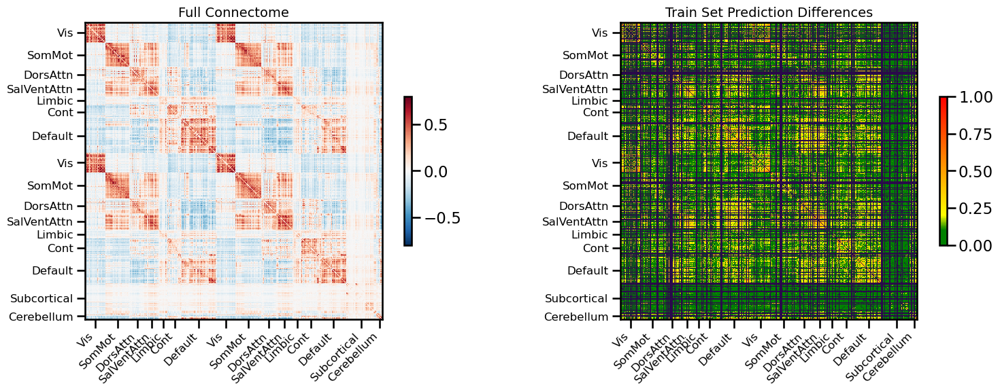

<Figure size 640x480 with 0 Axes>

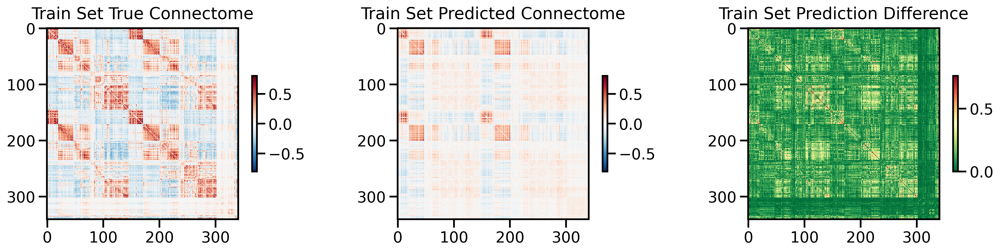

<Figure size 640x480 with 0 Axes>

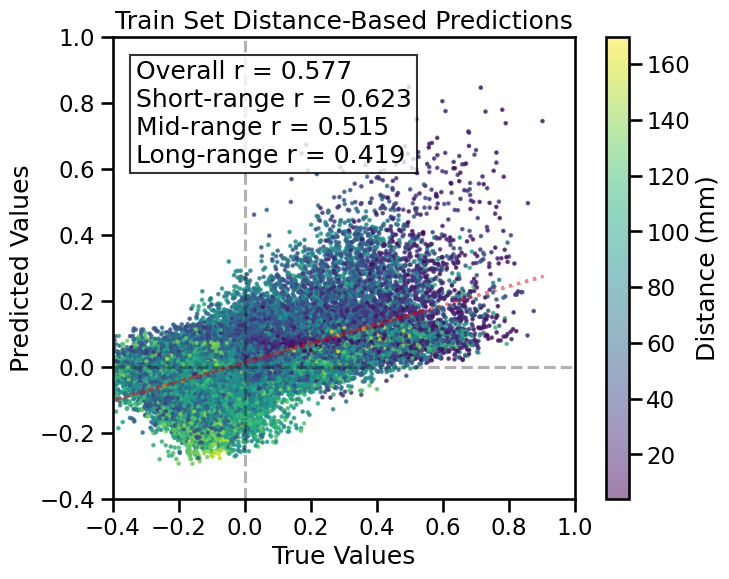

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 114 regions, 12882 connections


<Figure size 640x480 with 0 Axes>

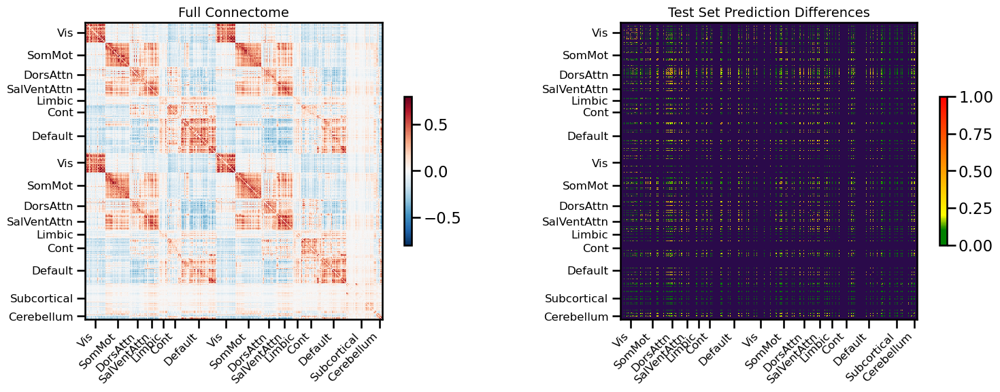

<Figure size 640x480 with 0 Axes>

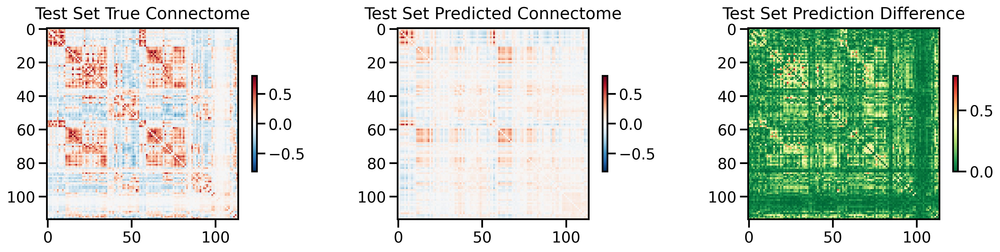

<Figure size 640x480 with 0 Axes>

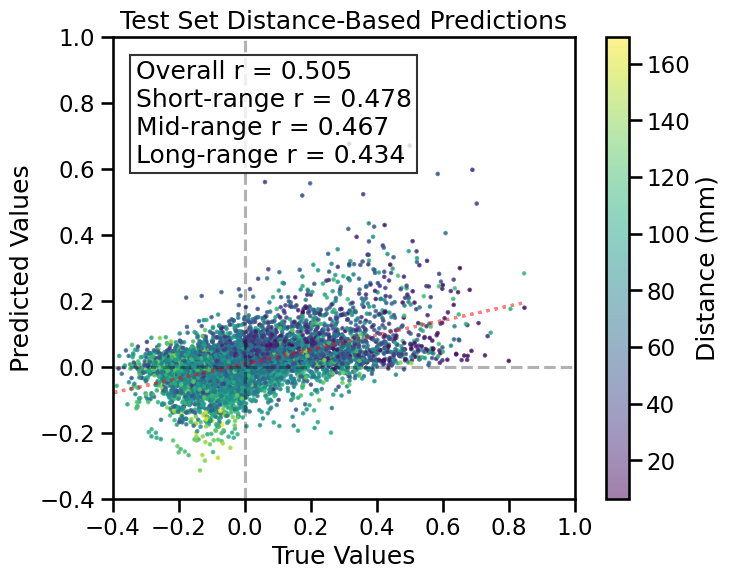

TRAIN METRICS
GLOBAL: mse=0.022794, mae=0.111056, r2=0.3271, pearson_r=0.5773, spearman_r=0.5681, geodesic_distance=34.5467
DISTANCE-BASED: short=0.6226, mid=0.5148, long=0.4190
HEMISPHERIC: left=0.5791, right=0.5846, inter=0.5770
CONNECTION STRENGTH: neg=0.0481, weak=0.4771, pos=0.2308
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.6922    0.6383
  Default       0.3425    0.5448
  SalVentAttn    0.7783    0.6764
  Limbic        0.7825    0.6660
  DorsAttn      0.7778    0.6836
  SomMot        0.7139    0.6581
  Vis           0.6323    0.6423
  Subcortical    0.5267    0.5687
  Cerebellum    0.7998    0.5846

TEST METRICS
GLOBAL: mse=0.024630, mae=0.114826, r2=0.2477, pearson_r=0.5054, spearman_r=0.5011, geodesic_distance=20.9621
DISTANCE-BASED: short=0.4780, mid=0.4668, long=0.4341
HEMISPHERIC: left=0.4837, right=0.5635, inter=0.4986
CONNECTION STRENGTH: neg=-0.1649, weak=0.4176, pos=0.1774
NETWORK CORRELATIONS:
  NETWORK      

0

<Figure size 640x480 with 0 Axes>

In [10]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              train_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              dataset='UKBB',
              parcellation='S456',
              hemisphere='both',
              connectome_target='FC',
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='100_var',
              cv_type='random',
              random_seed=42,
              search_method=('wandb', 'mse', 2),
              track_wandb=False,
              skip_cv=True,
              model_type='bilinear_lowrank',
              use_gpu=True,
              null_model='none',
              use_folds=[0]
)

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

Number of components for 95% variance PCA: 3
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 100)
X_pca shape: (455, 3)
X_pca_full shape: (455, 100)
X_cell_types_Jorstad shape: (455, 24)
X_cell_types_LakeDFC shape: (455, 18)
X_cell_types_LakeVIS shape: (455, 18)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
connectome target FC
Y shape (455, 455)
feature_name: transcriptome, processing_type: None
features ['transcriptome']
Feature matrix, X, generated... expanding to pairwise dataset


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: 8vb1ebyy
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/8vb1ebyy
Initialized sweep with ID: 8vb1ebyy


  warnings.warn(

  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



2
3
4
BEST CONFIG {'input_dim': 200, 'hidden_dims': [512, 256, 128], 'learning_rate': 9e-05, 'batch_size': 512, 'dropout_rate': 0.1, 'weight_decay': 0.0001, 'epochs': 125}
Number of learnable parameters in MLP: 269057


  from IPython.core.display import HTML, display  # type: ignore



Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.06 GB
Best val loss so far at epoch 1: 0.0285
Best val loss so far at epoch 2: 0.0247
Best val loss so far at epoch 3: 0.0231
Best val loss so far at epoch 4: 0.0215
Best val loss so far at epoch 5: 0.0203
Epoch 5/125, Train Loss: 0.0310, Val Loss: 0.0203, Time: 1.06s
Best val loss so far at epoch 6: 0.0188
Best val loss so far at epoch 8: 0.0184
Epoch 10/125, Train Loss: 0.0183, Val Loss: 0.0184, Time: 1.03s
Best val loss so far at epoch 11: 0.0180
Best val loss so far at epoch 12: 0.0173
Epoch 15/125, Train Loss: 0.0145, Val Loss: 0.0187, Time: 1.02s
Best val loss so far at epoch 18: 0.0163
Epoch 20/125, Train Loss: 0.0124, Val Loss: 0.0283, Time: 1.55s
Epoch 25/125, Train Loss: 0.0107, Val Loss: 0.0163, Time: 1.02s
Best val loss so far at epoch 27: 0.0158
Epoch 30/125, Train Loss: 0.0094, Val Loss: 0.0176, Time: 1.07s
Epoch 35/125, Train Loss: 0.0085, Val Loss: 0.0235, Time: 1.02s

LR REDUCED: 0.000090 → 0.000027 

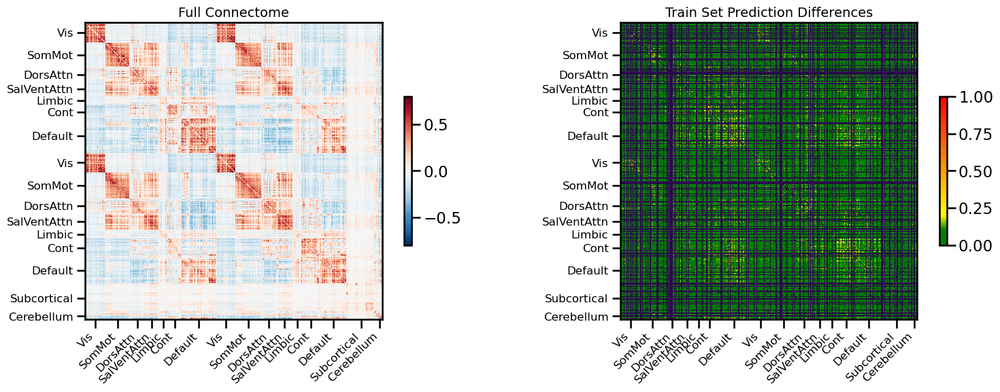

<Figure size 640x480 with 0 Axes>

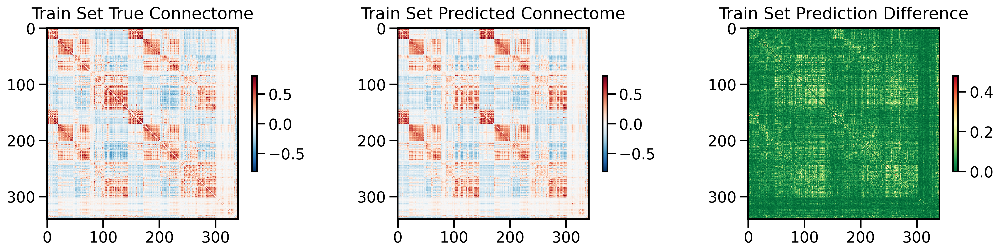

<Figure size 640x480 with 0 Axes>

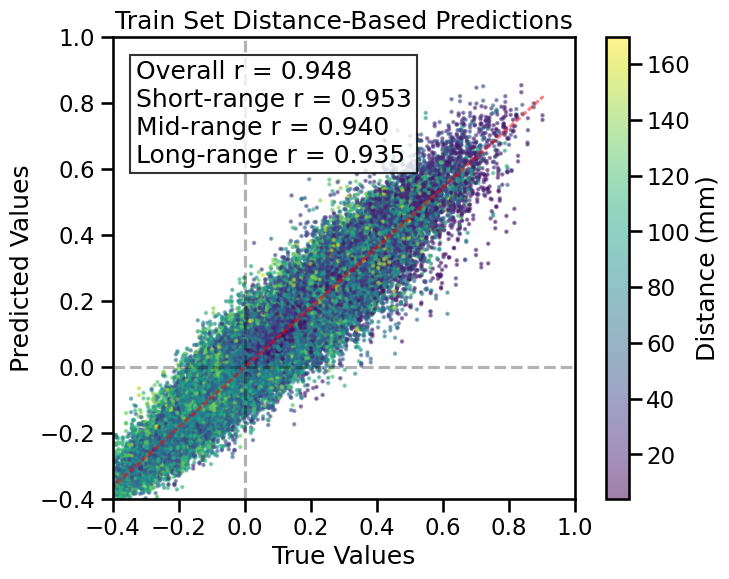

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 114 regions, 12882 connections


<Figure size 640x480 with 0 Axes>

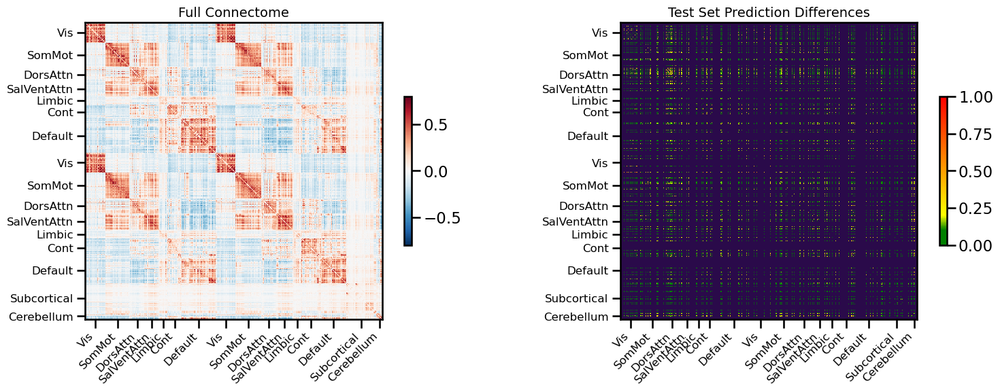

<Figure size 640x480 with 0 Axes>

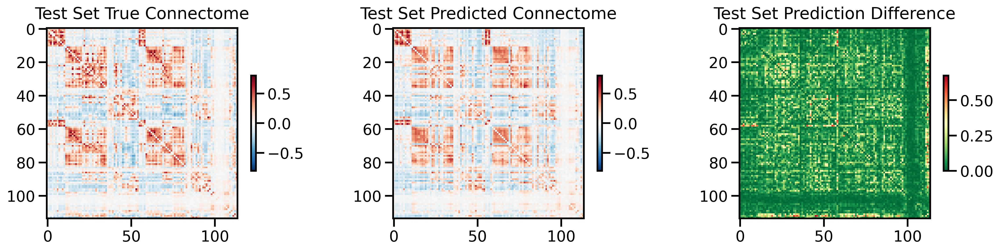

<Figure size 640x480 with 0 Axes>

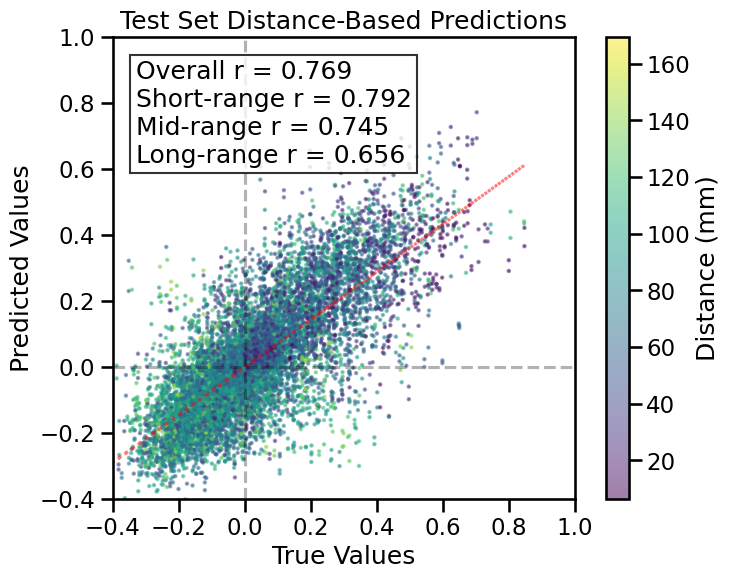

TRAIN METRICS
GLOBAL: mse=0.003470, mae=0.041997, r2=0.8976, pearson_r=0.9475, spearman_r=0.9366, geodesic_distance=17.1097
DISTANCE-BASED: short=0.9528, mid=0.9403, long=0.9353
HEMISPHERIC: left=0.9472, right=0.9532, inter=0.9503
CONNECTION STRENGTH: neg=0.5009, weak=0.9098, pos=0.7217
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.9443    0.9464
  Default       0.9173    0.9379
  SalVentAttn    0.9456    0.9525
  Limbic        0.9444    0.9596
  DorsAttn      0.9570    0.9599
  SomMot        0.9717    0.9582
  Vis           0.9761    0.9634
  Subcortical    0.9350    0.9433
  Cerebellum    0.9757    0.9434

TEST METRICS
GLOBAL: mse=0.014408, mae=0.083447, r2=0.5599, pearson_r=0.7686, spearman_r=0.7433, geodesic_distance=11.6120
DISTANCE-BASED: short=0.7923, mid=0.7451, long=0.6559
HEMISPHERIC: left=0.7515, right=0.7901, inter=0.7666
CONNECTION STRENGTH: neg=-0.1490, weak=0.6803, pos=0.3849
NETWORK CORRELATIONS:
  NETWORK      

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,█▆▅▄▄▃▄▂▄▂▂▅▂▂▄▂▂▄▂▁▁▁▂▁▁▂▁▁▂▁▁▁▂▂▁▁▁▁▁▁
train_mse_loss,█▃▃▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
best_val_loss,0
test_mse_loss,0.01426
train_mse_loss,0.00567


Final evaluation metrics logged successfully.
CPU Usage: 48.6%
RAM Usage: 35.3%
Available RAM: 978.4G
Total RAM: 1.5T
| ID | GPU | MEM |
------------------
|  0 |  0% |  1% |
Sim complete
Simulation completed in 164.30 seconds (2.74 minutes)


0

<Figure size 640x480 with 0 Axes>

In [9]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              train_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              dataset='UKBB',
              parcellation='S456',
              hemisphere='both',
              connectome_target='FC',
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='100_var',
              cv_type='random',
              random_seed=42,
              search_method=('wandb', 'mse', 2),
              track_wandb=True,
              skip_cv=True,
              model_type='dynamic_mlp',
              use_gpu=True,
              null_model='none',
              use_folds=[0]
)

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

Number of components for 95% variance PCA: 3
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 100)
X_pca shape: (455, 3)
X_pca_full shape: (455, 100)
X_cell_types_Jorstad shape: (455, 24)
X_cell_types_LakeDFC shape: (455, 18)
X_cell_types_LakeVIS shape: (455, 18)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
connectome target FC
Y shape (455, 455)
feature_name: transcriptome, processing_type: None
features ['transcriptome']
Feature matrix, X, generated... expanding to pairwise dataset


wandb: WARNING Calling wandb.login() after wandb.init() has no effect.
wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: vbxo1tuj
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/vbxo1tuj
Initialized sweep with ID: vbxo1tuj


  warnings.warn(



2
3
4
BEST CONFIG {'input_dim': 200, 'token_encoder_dim': 1, 'd_model': 128, 'encoder_output_dim': 1, 'use_alibi': True, 'nhead': 4, 'num_layers': 4, 'deep_hidden_dims': [512, 256, 128], 'transformer_dropout': 0.2, 'dropout_rate': 0.2, 'learning_rate': 9e-05, 'weight_decay': 0.0001, 'batch_size': 512, 'aug_prob': 0.3, 'aug_style': 'curriculum_swap_constant', 'epochs': 110, 'num_workers': 2, 'prefetch_factor': 4}
Number of learnable parameters in SMT model: 996482
Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.08 GB


Exception ignored in: <function ExactWeakKeyDictionary.__setitem__.<locals>.<lambda> at 0x151079b647c0>
Traceback (most recent call last):
  File "/ext3/miniconda3/lib/python3.11/site-packages/torch/_dynamo/utils.py", line 478, in <lambda>
    self.refs[idx] = weakref.ref(key, lambda ref: self._remove_id(idx))
                                                  ^^^^^^^^^^^^^^^^^^^^
  File "/ext3/miniconda3/lib/python3.11/site-packages/torch/_dynamo/utils.py", line 775, in _remove_id
    hook()
  File "/ext3/miniconda3/lib/python3.11/site-packages/torch/_dynamo/utils.py", line 759, in __call__
    del self.scope[self.name]
        ~~~~~~~~~~^^^^^^^^^^^
KeyError: '__builtins_dict___44'
Exception ignored in: <function ExactWeakKeyDictionary.__setitem__.<locals>.<lambda> at 0x15139a3f8220>
Traceback (most recent call last):
  File "/ext3/miniconda3/lib/python3.11/site-packages/torch/_dynamo/utils.py", line 478, in <lambda>
    self.refs[idx] = weakref.ref(key, lambda ref: self._remove_id(idx

Best val loss so far at epoch 1: 0.0432
Best val loss so far at epoch 2: 0.0350
Best val loss so far at epoch 3: 0.0329
Best val loss so far at epoch 4: 0.0321
Best val loss so far at epoch 5: 0.0313
Epoch 5/110, Train Loss: 0.1115, Val Loss: 0.0313, Time: 5.07s
Best val loss so far at epoch 6: 0.0303
Best val loss so far at epoch 7: 0.0262
Best val loss so far at epoch 9: 0.0230
Best val loss so far at epoch 10: 0.0215
Epoch 10/110, Train Loss: 0.0677, Val Loss: 0.0215, Time: 4.38s
Best val loss so far at epoch 11: 0.0212
Best val loss so far at epoch 12: 0.0207
Best val loss so far at epoch 13: 0.0187
Best val loss so far at epoch 15: 0.0183
Epoch 15/110, Train Loss: 0.0662, Val Loss: 0.0183, Time: 5.01s
Best val loss so far at epoch 18: 0.0181
Epoch 20/110, Train Loss: 0.0548, Val Loss: 0.0188, Time: 4.94s
Epoch 25/110, Train Loss: 0.0555, Val Loss: 0.0198, Time: 4.95s
Best val loss so far at epoch 29: 0.0178
Epoch 30/110, Train Loss: 0.0488, Val Loss: 0.0178, Time: 4.96s
Best val l

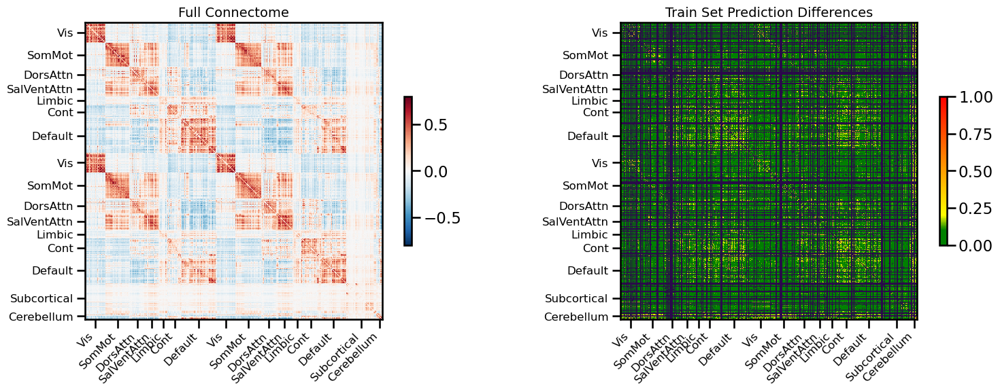

<Figure size 640x480 with 0 Axes>

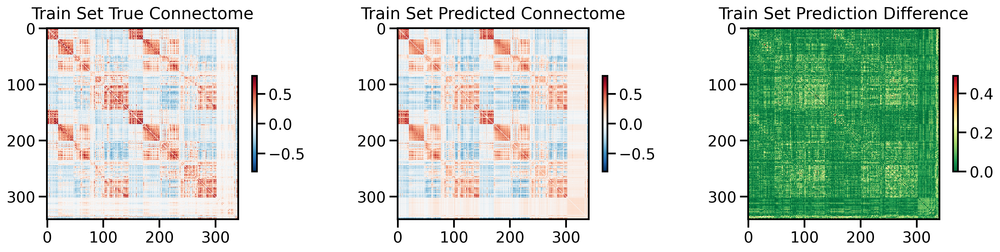

<Figure size 640x480 with 0 Axes>

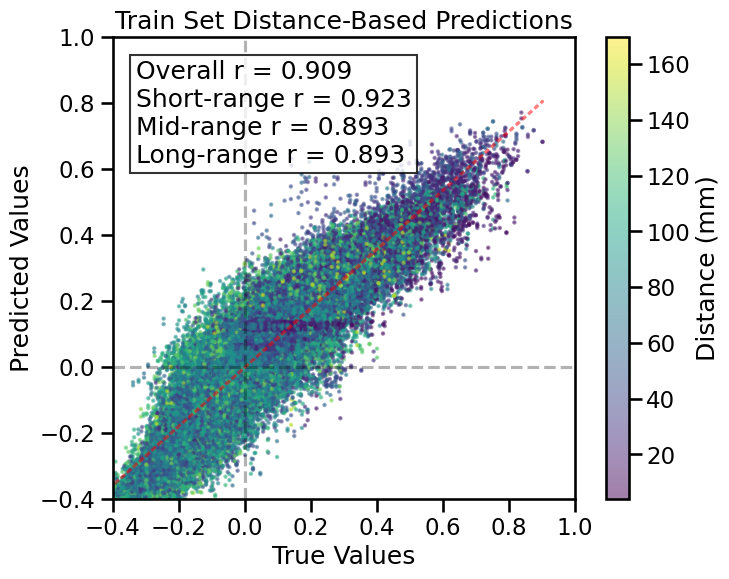

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 114 regions, 12882 connections


<Figure size 640x480 with 0 Axes>

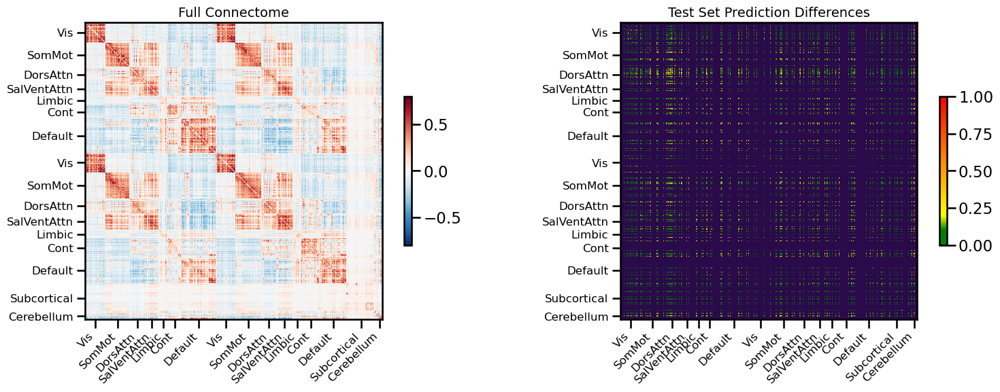

<Figure size 640x480 with 0 Axes>

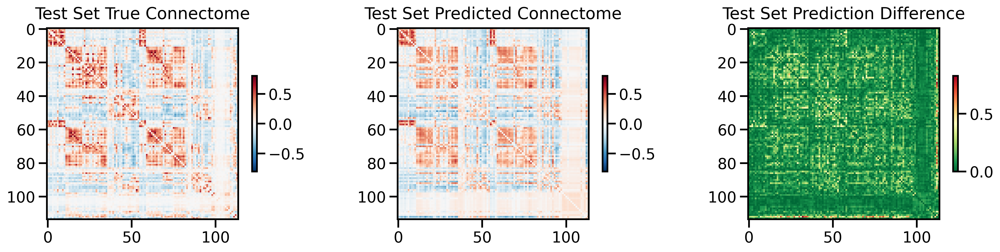

<Figure size 640x480 with 0 Axes>

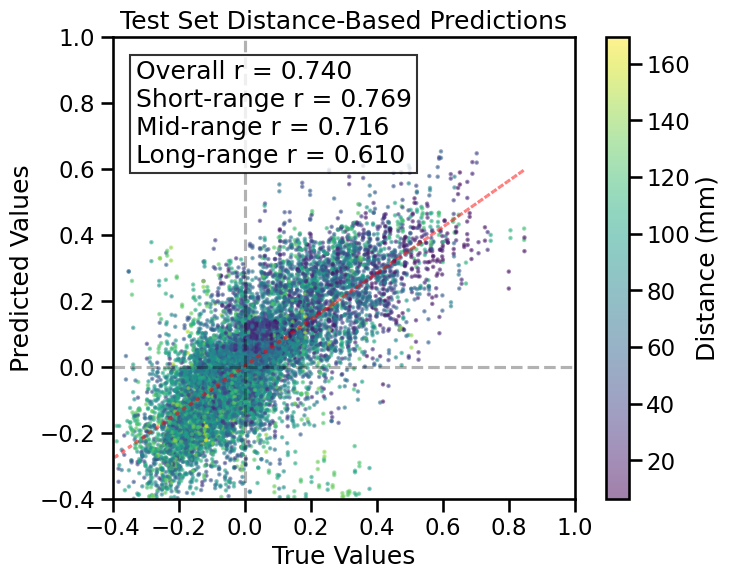

TRAIN METRICS
GLOBAL: mse=0.006080, mae=0.058991, r2=0.8205, pearson_r=0.9089, spearman_r=0.8837, geodesic_distance=19.3658
DISTANCE-BASED: short=0.9228, mid=0.8935, long=0.8930
HEMISPHERIC: left=0.9075, right=0.9203, inter=0.9088
CONNECTION STRENGTH: neg=0.5885, weak=0.8479, pos=0.7436
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.9075    0.9123
  Default       0.8731    0.8981
  SalVentAttn    0.9117    0.9221
  Limbic        0.9088    0.9324
  DorsAttn      0.9155    0.9311
  SomMot        0.9401    0.9263
  Vis           0.9426    0.9372
  Subcortical    0.8893    0.9034
  Cerebellum    0.9472    0.8988

TEST METRICS
GLOBAL: mse=0.016248, mae=0.090884, r2=0.5037, pearson_r=0.7401, spearman_r=0.7376, geodesic_distance=12.5842
DISTANCE-BASED: short=0.7693, mid=0.7159, long=0.6104
HEMISPHERIC: left=0.7029, right=0.7941, inter=0.7466
CONNECTION STRENGTH: neg=-0.0936, weak=0.6622, pos=0.3689
NETWORK CORRELATIONS:
  NETWORK      

12005

<Figure size 640x480 with 0 Axes>

In [20]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              train_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              dataset='UKBB',
              parcellation='S456',
              hemisphere='both',
              connectome_target='FC',
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='100_var',
              cv_type='random',
              random_seed=42,
              search_method=('wandb', 'mse', 2),
              track_wandb=False,
              skip_cv=True,
              model_type='shared_transformer',
              use_gpu=True,
              null_model='none',
              use_folds=[0]
)

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

Number of components for 95% variance PCA: 3
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 100)
X_pca shape: (455, 3)
X_pca_full shape: (455, 100)
X_cell_types_Jorstad shape: (455, 24)
X_cell_types_LakeDFC shape: (455, 18)
X_cell_types_LakeVIS shape: (455, 18)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
connectome target FC
Y shape (455, 455)
feature_name: transcriptome, processing_type: None
features ['transcriptome']
Feature matrix, X, generated... expanding to pairwise dataset


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: kr9qnyyf
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/kr9qnyyf
Initialized sweep with ID: kr9qnyyf
2
3
4
BEST CONFIG {'input_dim': 200, 'expression_bins': 5, 'genevec_type': 'gene2vec', 'd_model': 32, 'nhead': 1, 'num_layers': 1, 'deep_hidden_dims': [256, 128], 'cls_init': 'random', 'pooling_mode': 'linear', 'use_alibi': False, 'transformer_dropout': 0.0, 'dropout_rate': 0.0, 'learning_rate': 0.0001, 'weight_decay': 0.0, 'batch_size': 512, 'epochs': 100, 'aug_prob': 0.0, 'aug_style': 'linear_decay', 'lambda_sym': 0.0, 'num_workers': 2, 'prefetch_factor': 4, 'cosine_lr': False}


  warnings.warn(

  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



Loaded Gene2Vec embeddings: 94 genes with 200-dimensional embeddings
Gene overlap: 94/100 valid genes have Gene2Vec embeddings
Number of learnable parameters in CrossAttentionGeneVec model: 74600
Expression bins: 5
CLS token initialization: random


  from IPython.core.display import HTML, display  # type: ignore



Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.06 GB
Best val loss so far at epoch 1: 0.1255
Best val loss so far at epoch 2: 0.1152
Best val loss so far at epoch 3: 0.1106
Best val loss so far at epoch 4: 0.1043
Best val loss so far at epoch 5: 0.0926
Epoch 5/100, Train Loss: 0.0320, Val Loss: 0.0926, Time: 1.43s
Best val loss so far at epoch 6: 0.0838
Best val loss so far at epoch 8: 0.0782
Best val loss so far at epoch 10: 0.0756
Epoch 10/100, Train Loss: 0.0286, Val Loss: 0.0756, Time: 1.41s
Best val loss so far at epoch 11: 0.0668
Best val loss so far at epoch 13: 0.0655
Best val loss so far at epoch 14: 0.0581
Best val loss so far at epoch 15: 0.0577
Epoch 15/100, Train Loss: 0.0261, Val Loss: 0.0577, Time: 1.40s
Best val loss so far at epoch 17: 0.0570
Best val loss so far at epoch 18: 0.0542
Epoch 20/100, Train Loss: 0.0239, Val Loss: 0.0552, Time: 1.41s
Best val loss so far at epoch 21: 0.0540
Best val loss so far at epoch 23: 0.0494
Epoch 25/100, Train 

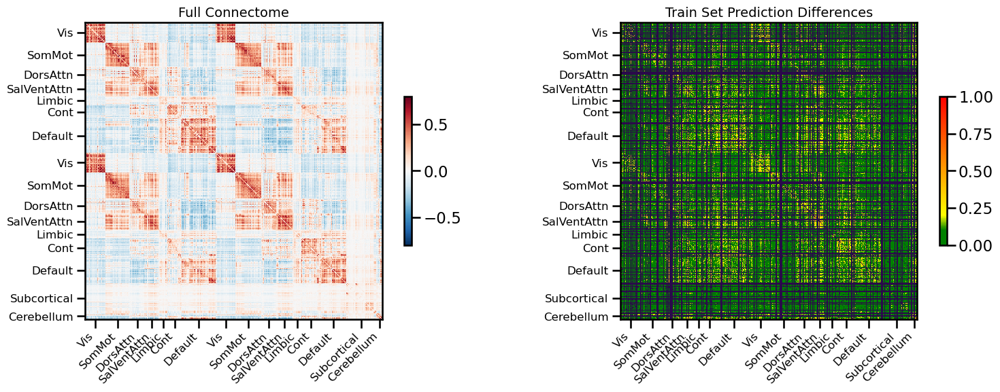

<Figure size 640x480 with 0 Axes>

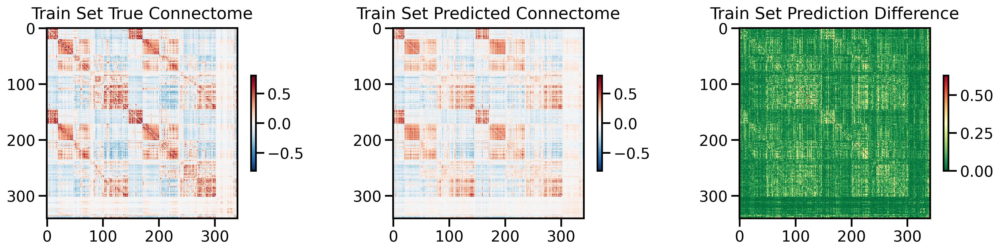

<Figure size 640x480 with 0 Axes>

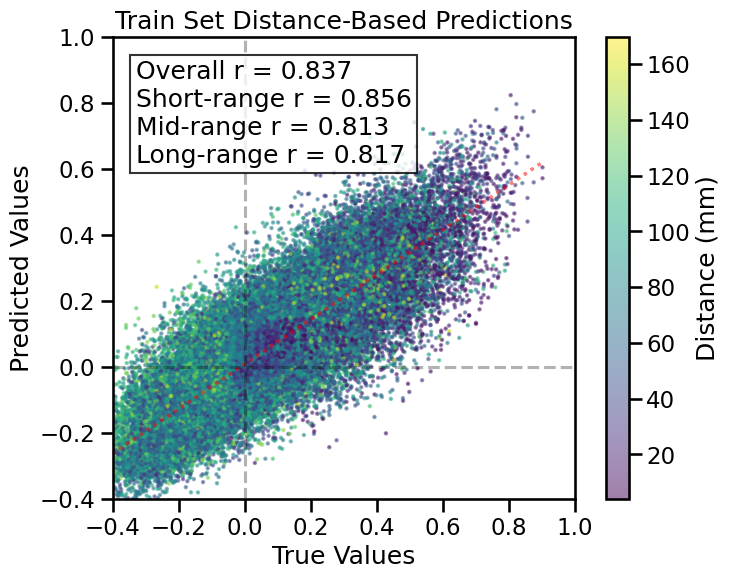

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 114 regions, 12882 connections


<Figure size 640x480 with 0 Axes>

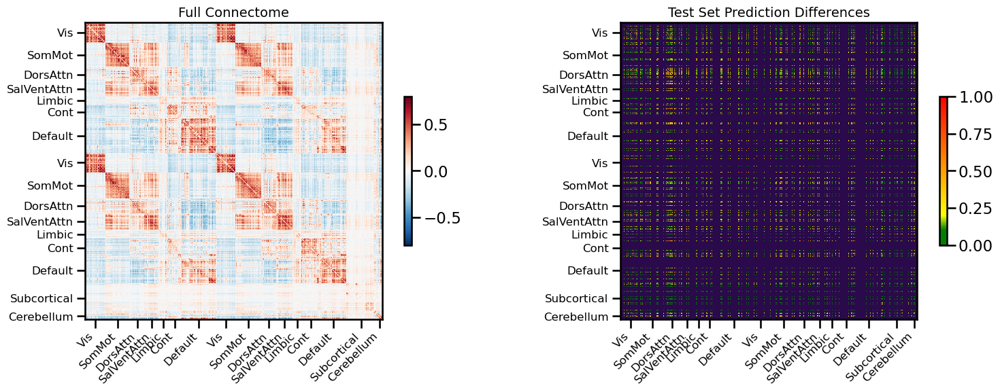

<Figure size 640x480 with 0 Axes>

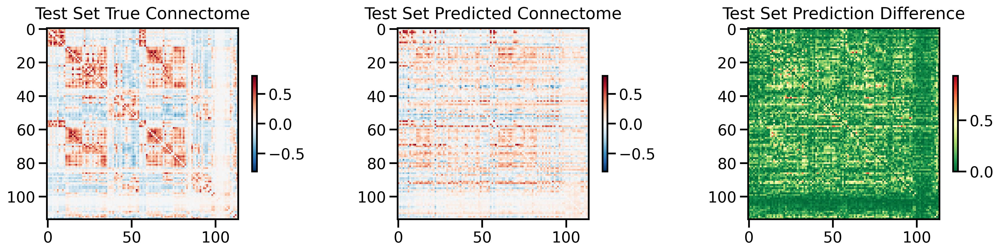

<Figure size 640x480 with 0 Axes>

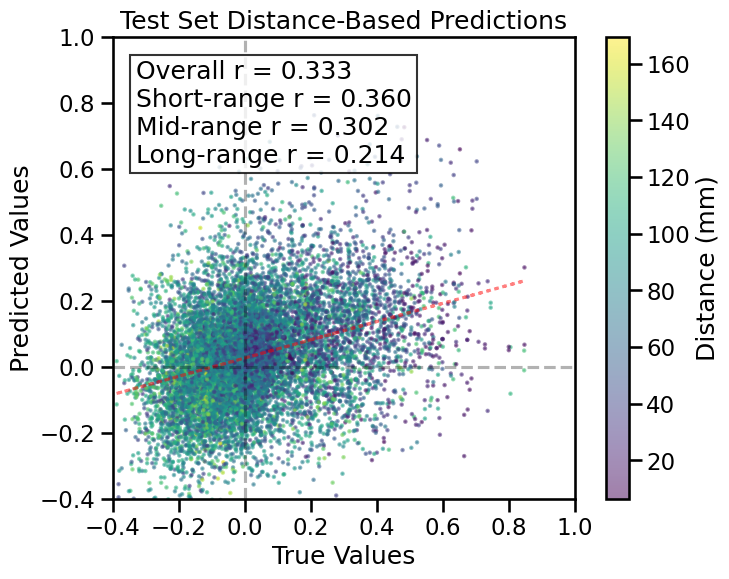

TRAIN METRICS
GLOBAL: mse=0.010203, mae=0.073299, r2=0.6988, pearson_r=0.8366, spearman_r=0.8067, geodesic_distance=26.1495
DISTANCE-BASED: short=0.8562, mid=0.8126, long=0.8167
HEMISPHERIC: left=0.8419, right=0.8440, inter=0.8284
CONNECTION STRENGTH: neg=0.2281, weak=0.7523, pos=0.4714
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.8445    0.8483
  Default       0.7471    0.8202
  SalVentAttn    0.8705    0.8691
  Limbic        0.8558    0.8695
  DorsAttn      0.8353    0.8619
  SomMot        0.8840    0.8742
  Vis           0.8749    0.8613
  Subcortical    0.7187    0.8266
  Cerebellum    0.7170    0.8150

TEST METRICS
GLOBAL: mse=0.037228, mae=0.144567, r2=-0.1371, pearson_r=0.3334, spearman_r=0.3300, geodesic_distance=17.8125
DISTANCE-BASED: short=0.3597, mid=0.3019, long=0.2144
HEMISPHERIC: left=0.3506, right=0.3612, inter=0.3223
CONNECTION STRENGTH: neg=0.0293, weak=0.2786, pos=0.1089
NETWORK CORRELATIONS:
  NETWORK      

  from IPython.core.display import display



  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,█▇▆▄▄▃▃▃▂▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_mse_loss,█▅▅▅▄▄▄▄▄▃▃▃▃▃▃▂▂▂▂▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁
best_val_loss,0
test_mse_loss,0.03659
train_mse_loss,0.01033


Final evaluation metrics logged successfully.
CPU Usage: 8.4%
RAM Usage: 12.6%
Available RAM: 1.3T
Total RAM: 1.5T
| ID | GPU | MEM |
------------------
|  0 |  0% |  1% |
Sim complete
Simulation completed in 176.45 seconds (2.94 minutes)


3779

<Figure size 640x480 with 0 Axes>

In [20]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              train_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              dataset='UKBB',
              parcellation='S456',
              hemisphere='both',
              connectome_target='FC',
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='100_var',
              cv_type='random',
              random_seed=42,
              search_method=('wandb', 'mse', 2),
              track_wandb=True,
              skip_cv=True,
              model_type='cross_attention_genevec',
              use_gpu=True,
              null_model='none',
              use_folds=[0]
)

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

Number of components for 95% variance PCA: 3
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 100)
X_pca shape: (455, 3)
X_pca_full shape: (455, 100)
X_cell_types_Jorstad shape: (455, 24)
X_cell_types_LakeDFC shape: (455, 18)
X_cell_types_LakeVIS shape: (455, 18)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
connectome target FC
Y shape (455, 455)
feature_name: transcriptome, processing_type: None
features ['transcriptome']
Feature matrix, X, generated... expanding to pairwise dataset


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: f7m3fadd
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/f7m3fadd
Initialized sweep with ID: f7m3fadd
2
3
4
BEST CONFIG {'input_dim': 200, 'expression_bins': 5, 'genevec_type': 'gene2vec', 'd_model': 32, 'nhead': 1, 'num_layers': 1, 'deep_hidden_dims': [256, 128], 'cls_init': 'random', 'pooling_mode': 'attention', 'use_alibi': False, 'transformer_dropout': 0.0, 'dropout_rate': 0.0, 'learning_rate': 0.0001, 'weight_decay': 0.0, 'batch_size': 512, 'epochs': 100, 'aug_prob': 0.0, 'aug_style': 'linear_decay', 'lambda_sym': 0.0, 'num_workers': 2, 'prefetch_factor': 4, 'cosine_lr': False}


  warnings.warn(

  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



Loaded Gene2Vec embeddings: 94 genes with 200-dimensional embeddings
Gene overlap: 94/100 valid genes have Gene2Vec embeddings
Number of learnable parameters in CrossAttentionGeneVec model: 61960
Expression bins: 5
CLS token initialization: random


  from IPython.core.display import HTML, display  # type: ignore



Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.06 GB
Best val loss so far at epoch 1: 0.0373
Best val loss so far at epoch 2: 0.0343
Best val loss so far at epoch 3: 0.0333
Best val loss so far at epoch 4: 0.0333
Best val loss so far at epoch 5: 0.0326
Epoch 5/100, Train Loss: 0.0310, Val Loss: 0.0326, Time: 1.50s
Best val loss so far at epoch 7: 0.0318
Best val loss so far at epoch 9: 0.0316
Best val loss so far at epoch 10: 0.0315
Epoch 10/100, Train Loss: 0.0296, Val Loss: 0.0315, Time: 1.50s
Best val loss so far at epoch 11: 0.0308
Epoch 15/100, Train Loss: 0.0285, Val Loss: 0.0311, Time: 1.55s
Best val loss so far at epoch 16: 0.0303
Epoch 20/100, Train Loss: 0.0275, Val Loss: 0.0313, Time: 1.56s
Epoch 25/100, Train Loss: 0.0263, Val Loss: 0.0312, Time: 1.53s
Best val loss so far at epoch 26: 0.0295
Best val loss so far at epoch 28: 0.0295
Best val loss so far at epoch 29: 0.0290
Epoch 30/100, Train Loss: 0.0244, Val Loss: 0.0299, Time: 1.48s
Best val loss s

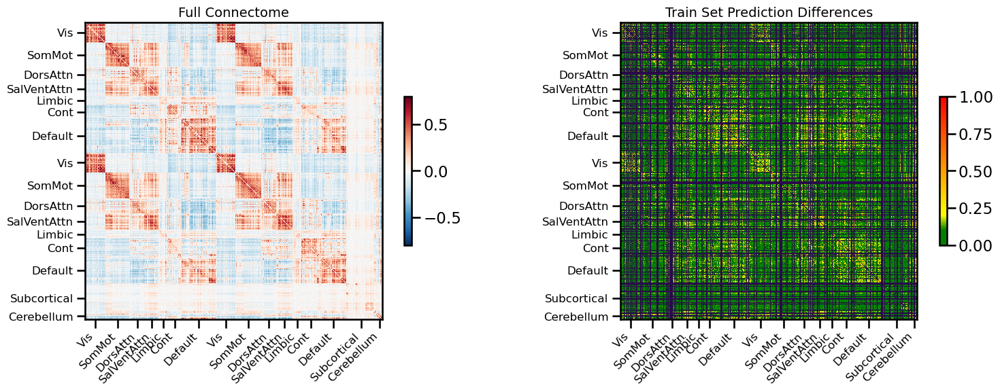

<Figure size 640x480 with 0 Axes>

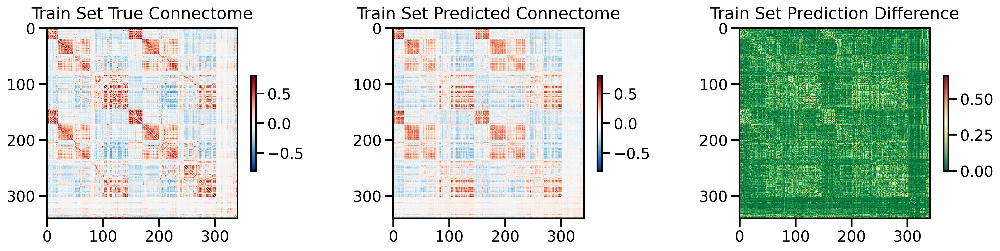

<Figure size 640x480 with 0 Axes>

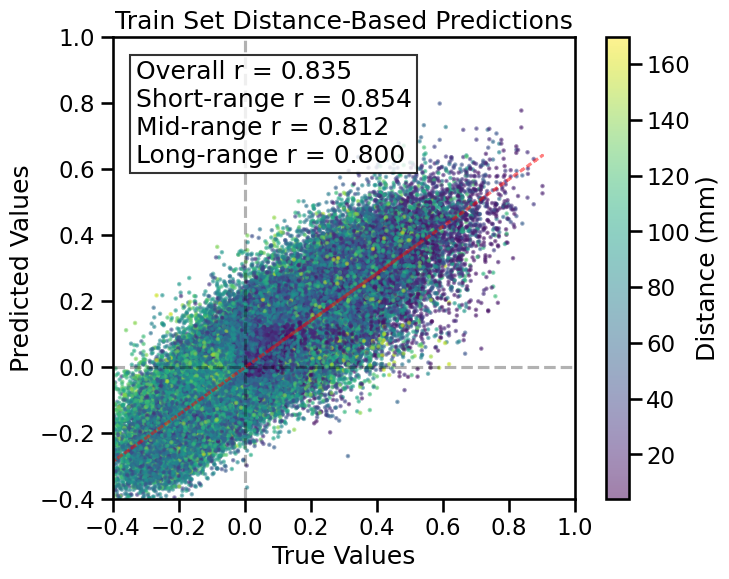

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 114 regions, 12882 connections


<Figure size 640x480 with 0 Axes>

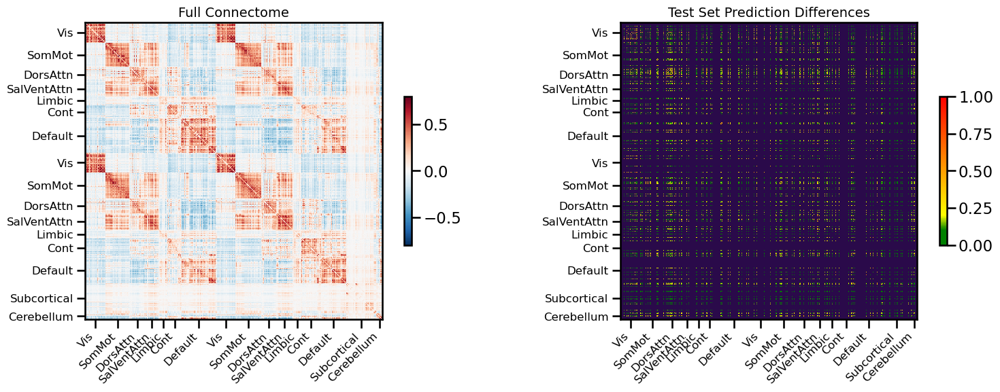

<Figure size 640x480 with 0 Axes>

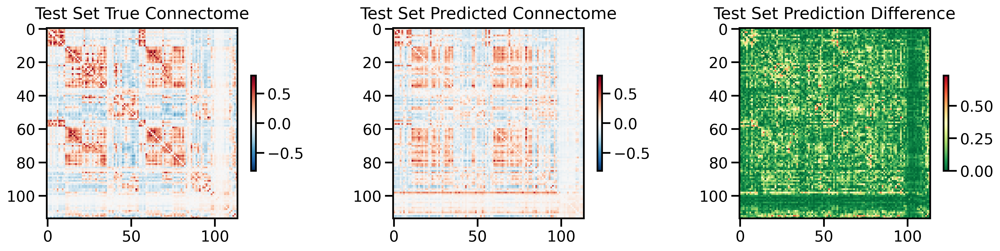

<Figure size 640x480 with 0 Axes>

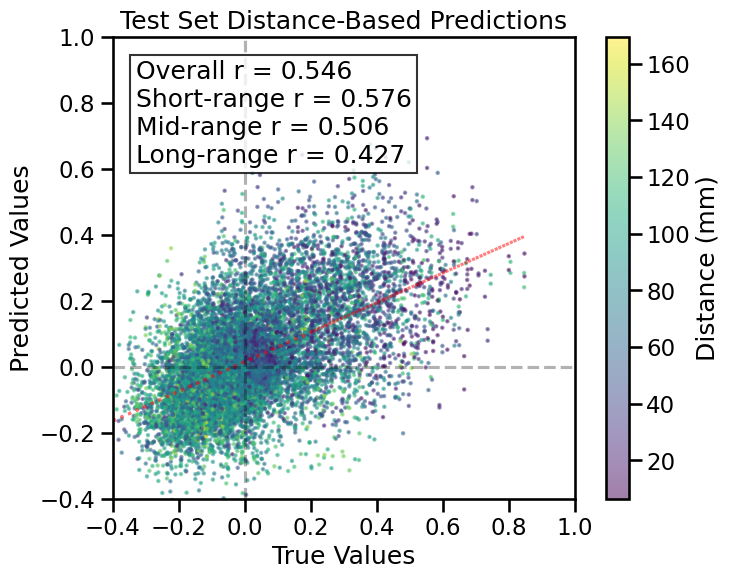

TRAIN METRICS
GLOBAL: mse=0.010338, mae=0.075463, r2=0.6948, pearson_r=0.8345, spearman_r=0.8027, geodesic_distance=25.3571
DISTANCE-BASED: short=0.8539, mid=0.8122, long=0.8001
HEMISPHERIC: left=0.8402, right=0.8587, inter=0.8254
CONNECTION STRENGTH: neg=0.2087, weak=0.7500, pos=0.4550
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.8461    0.8517
  Default       0.7519    0.8218
  SalVentAttn    0.8530    0.8706
  Limbic        0.8132    0.8729
  DorsAttn      0.8382    0.8698
  SomMot        0.8778    0.8658
  Vis           0.8647    0.8678
  Subcortical    0.6508    0.8202
  Cerebellum    0.7666    0.7950

TEST METRICS
GLOBAL: mse=0.025454, mae=0.118323, r2=0.2225, pearson_r=0.5461, spearman_r=0.5223, geodesic_distance=15.6566
DISTANCE-BASED: short=0.5763, mid=0.5059, long=0.4273
HEMISPHERIC: left=0.5633, right=0.5761, inter=0.5683
CONNECTION STRENGTH: neg=-0.0912, weak=0.4569, pos=0.1478
NETWORK CORRELATIONS:
  NETWORK      

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,█▇▆▆▆▅▅▅▅▅▅▅▅▅▅▅▄▄▂▂▁▂▂▂▁▂▂▂▂▂▂▂▂▄▂▂▃▂▂▃
train_mse_loss,█▆▆▆▆▆▅▅▅▅▅▅▄▄▃▃▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
best_val_loss,0
test_mse_loss,0.0253
train_mse_loss,0.0105


Final evaluation metrics logged successfully.
CPU Usage: 7.4%
RAM Usage: 12.3%
Available RAM: 1.3T
Total RAM: 1.5T
| ID | GPU | MEM |
------------------
|  0 |  0% |  1% |
Sim complete
Simulation completed in 183.35 seconds (3.06 minutes)


4470

<Figure size 640x480 with 0 Axes>

In [21]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              train_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              dataset='UKBB',
              parcellation='S456',
              hemisphere='both',
              connectome_target='FC',
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='100_var',
              cv_type='random',
              random_seed=42,
              search_method=('wandb', 'mse', 2),
              track_wandb=True,
              skip_cv=True,
              model_type='cross_attention_genevec',
              use_gpu=True,
              null_model='none',
              use_folds=[0]
)

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()

Number of components for 95% variance PCA: 3
Number of 1s: 36662, Number of 0s: 171274, Class balance (1s): 0.176
Number of 1s: 17738, Number of 0s: 190198, Class balance (1s): 0.085
X shape: (455, 100)
X_pca shape: (455, 3)
X_pca_full shape: (455, 100)
X_cell_types_Jorstad shape: (455, 24)
X_cell_types_LakeDFC shape: (455, 18)
X_cell_types_LakeVIS shape: (455, 18)
Y_sc shape: (455, 455)
Y_sc_spectralL shape: (455, 455)
Y_sc_spectralA shape: (455, 456)
Y_fc shape: (455, 455)
Coordinates shape: (455, 3)
connectome target FC
Y shape (455, 455)
feature_name: transcriptome, processing_type: None
features ['transcriptome']
Feature matrix, X, generated... expanding to pairwise dataset


wandb: WARNING Malformed sweep config detected! This may cause your sweep to behave in unexpected ways.
wandb: WARNING To avoid this, please fix the sweep config schema violations below:
wandb: WARNING   Violation 1. Additional properties are not allowed ('best_parameters' was unexpected)


Create sweep with ID: scmujj3k
Sweep URL: https://wandb.ai/alexander-ratzan-new-york-university/gx2conn/sweeps/scmujj3k
Initialized sweep with ID: scmujj3k
2
3
4
BEST CONFIG {'input_dim': 200, 'expression_bins': 5, 'genevec_type': 'gene2vec', 'd_model': 64, 'nhead': 4, 'num_layers': 4, 'deep_hidden_dims': [256, 128, 64], 'cls_init': 'random', 'pooling_mode': 'attention', 'use_alibi': True, 'transformer_dropout': 0.3, 'dropout_rate': 0.1, 'learning_rate': 9e-05, 'weight_decay': 0.001, 'batch_size': 1024, 'epochs': 200, 'aug_prob': 0.3, 'aug_style': 'curriculum_swap_linear_decay', 'lambda_sym': 0.0, 'bidirectional': True, 'num_workers': 2, 'prefetch_factor': 4, 'cosine_lr': False}


  warnings.warn(

  self.comm = Comm(**args)

  from IPython.core.display import HTML, display  # type: ignore



Loaded Gene2Vec embeddings: 94 genes with 200-dimensional embeddings
Gene overlap: 94/100 valid genes have Gene2Vec embeddings
Number of learnable parameters in CrossAttentionGeneVec model: 224904
Expression bins: 5
CLS token initialization: random


  from IPython.core.display import HTML, display  # type: ignore



Using device: cuda
GPU 0: NVIDIA H100 80GB HBM3 - Memory Allocated: 0.07 GB
Best val loss so far at epoch 1: 0.0917
Best val loss so far at epoch 2: 0.0503
Best val loss so far at epoch 3: 0.0370
Best val loss so far at epoch 4: 0.0332
Best val loss so far at epoch 5: 0.0316
Epoch 5/200, Train Loss: 0.0750, Val Loss: 0.0316, Time: 2.50s
Best val loss so far at epoch 6: 0.0316
Best val loss so far at epoch 7: 0.0314
Epoch 10/200, Train Loss: 0.0615, Val Loss: 0.0314, Time: 2.51s
Best val loss so far at epoch 14: 0.0312
Best val loss so far at epoch 15: 0.0309
Epoch 15/200, Train Loss: 0.0551, Val Loss: 0.0309, Time: 2.52s
Best val loss so far at epoch 16: 0.0307
Best val loss so far at epoch 17: 0.0303
Best val loss so far at epoch 19: 0.0296
Epoch 20/200, Train Loss: 0.0475, Val Loss: 0.0297, Time: 2.42s
Best val loss so far at epoch 21: 0.0294
Best val loss so far at epoch 22: 0.0293
Best val loss so far at epoch 23: 0.0289
Epoch 25/200, Train Loss: 0.0464, Val Loss: 0.0299, Time: 2.4

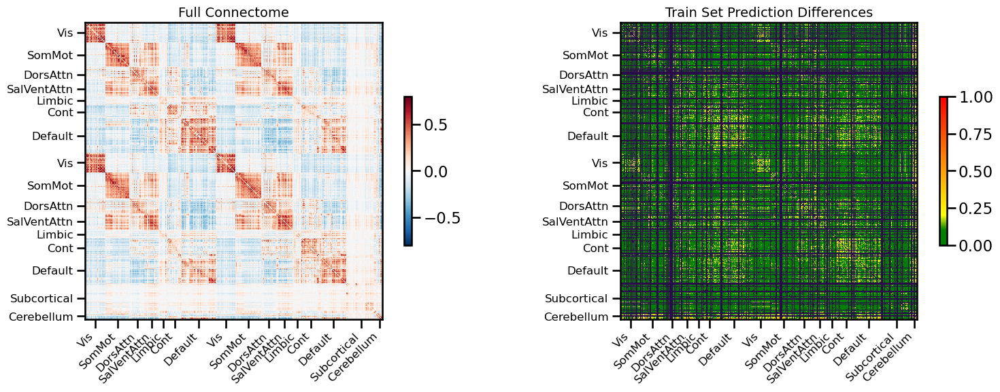

<Figure size 640x480 with 0 Axes>

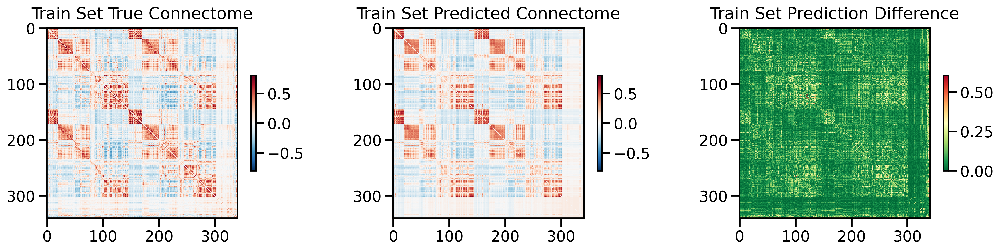

<Figure size 640x480 with 0 Axes>

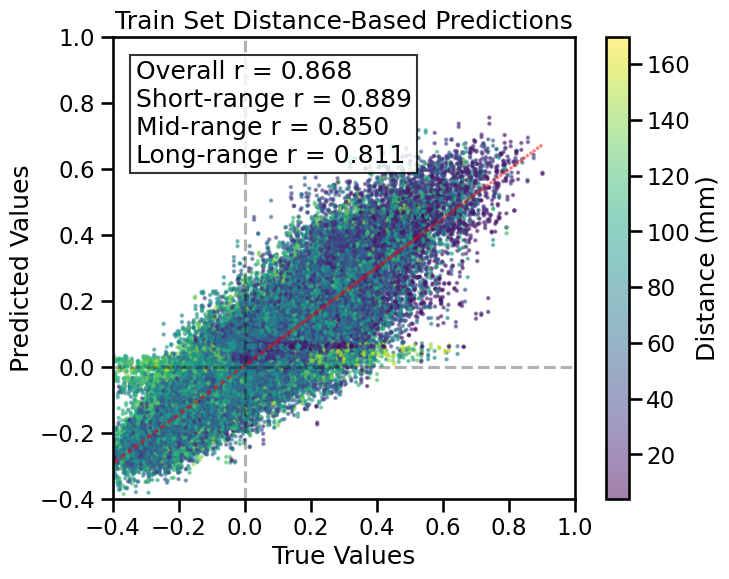

Running test evaluation...

=== TEST EVALUATION ===
Evaluating 114 regions, 12882 connections


<Figure size 640x480 with 0 Axes>

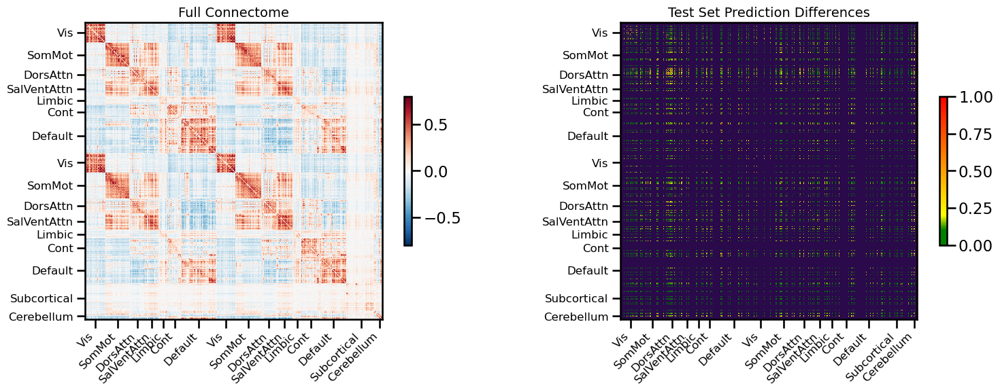

<Figure size 640x480 with 0 Axes>

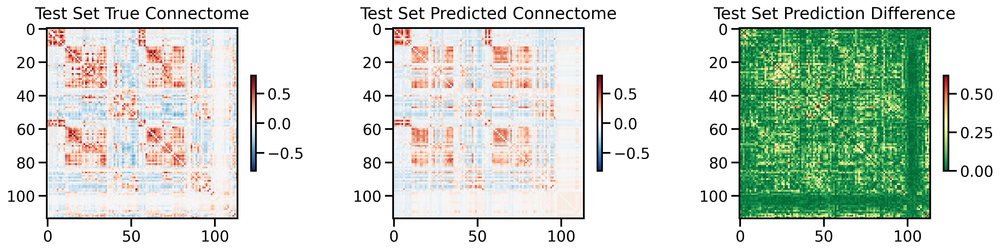

<Figure size 640x480 with 0 Axes>

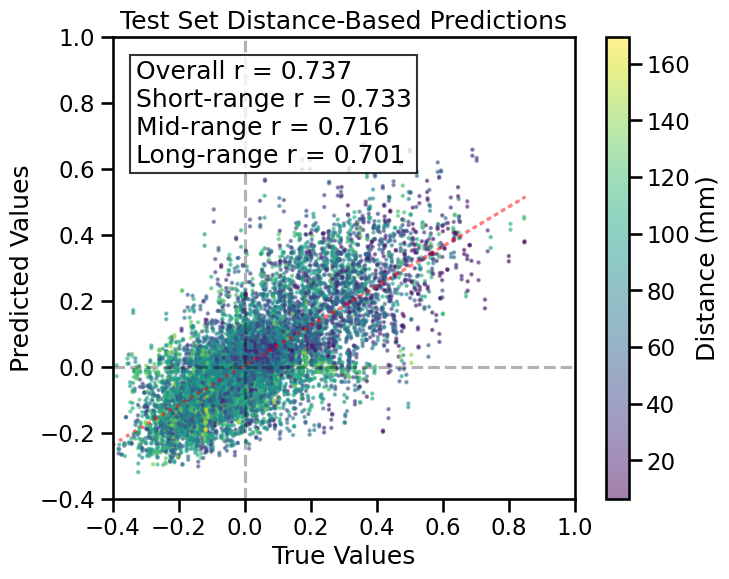

TRAIN METRICS
GLOBAL: mse=0.008339, mae=0.066228, r2=0.7538, pearson_r=0.8683, spearman_r=0.8365, geodesic_distance=20.2341
DISTANCE-BASED: short=0.8886, mid=0.8502, long=0.8109
HEMISPHERIC: left=0.8544, right=0.8895, inter=0.8688
CONNECTION STRENGTH: neg=0.1555, weak=0.7842, pos=0.5351
NETWORK CORRELATIONS:
  NETWORK      INTRA      INTER
  ------------------------------
  Cont          0.8732    0.8793
  Default       0.8196    0.8583
  SalVentAttn    0.8820    0.8838
  Limbic        0.8869    0.8996
  DorsAttn      0.8582    0.9003
  SomMot        0.9052    0.8894
  Vis           0.9122    0.9061
  Subcortical    0.7340    0.8623
  Cerebellum    0.7620    0.8496

TEST METRICS
GLOBAL: mse=0.015171, mae=0.088630, r2=0.5366, pearson_r=0.7370, spearman_r=0.7080, geodesic_distance=12.0546
DISTANCE-BASED: short=0.7329, mid=0.7162, long=0.7009
HEMISPHERIC: left=0.7063, right=0.7811, inter=0.7494
CONNECTION STRENGTH: neg=0.0855, weak=0.6467, pos=0.3640
NETWORK CORRELATIONS:
  NETWORK      I

  from IPython.core.display import HTML, display  # type: ignore



best_val_loss,▁
test_mse_loss,███▇▇▅▄▄▄▃▂▃▃▂▁▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
train_mse_loss,█▇▇▇▅▅▅▅▅▅▄▃▃▃▃▃▂▂▃▂▃▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁
best_val_loss,0
test_mse_loss,0.01505
train_mse_loss,0.01093


Final evaluation metrics logged successfully.
CPU Usage: 16.1%
RAM Usage: 8.0%
Available RAM: 1.4T
Total RAM: 1.5T
| ID | GPU | MEM |
------------------
|  0 |  0% |  1% |
Sim complete
Simulation completed in 582.94 seconds (9.72 minutes)


11195

<Figure size 640x480 with 0 Axes>

In [14]:
single_sim_run(
              feature_type=[{'transcriptome': None}],
              train_shared_regions=False,
              test_shared_regions=False,
              omit_subcortical=False,
              dataset='UKBB',
              parcellation='S456',
              hemisphere='both',
              connectome_target='FC',
              impute_strategy='mirror_interpolate',
              sort_genes='refgenome',
              gene_list='100_var',
              cv_type='random',
              random_seed=42,
              search_method=('wandb', 'mse', 2),
              track_wandb=True,
              skip_cv=True,
              model_type='cross_attention_genevec',
              use_gpu=True,
              null_model='none',
              use_folds=[0]
)

# Clear GPU memory
if torch.cuda.is_available():
    torch.cuda.empty_cache()

# Clear CPU memory
gc.collect()